# Bachelor-Notebook

### Data sources:
- [Games_of_all_time.csv](https://www.kaggle.com/datasets/xcherry/games-of-all-time-from-metacritic)
- [metacritic_games.csv](https://www.kaggle.com/datasets/skateddu/metacritic-all-time-games-stats)


In [12]:
#Initialisiert die benötigten Libraries
%matplotlib inline
import pandas as pd
import numpy as np
from scipy import stats
import seaborn as sns 
import matplotlib.pyplot as plt 

Code der Stata in Phython "aktiviert" 
von: https://www.stata.com/python/pystata/install.html 

In [13]:
import sys
#sys.path.append('/Applications/Stata/utilities')     # Apple Pfad
sys.path.append('C:/Program Files/Stata17/utilities')  # Windows Pfad
from pystata import config
config.init('mp')



  ___  ____  ____  ____  ____ ©
 /__    /   ____/   /   ____/      17.0
___/   /   /___/   /   /___/       MP—Parallel Edition

 Statistics and Data Science       Copyright 1985-2021 StataCorp LLC
                                   StataCorp
                                   4905 Lakeway Drive
                                   College Station, Texas 77845 USA
                                   800-STATA-PC        https://www.stata.com
                                   979-696-4600        stata@stata.com

Stata license: Unlimited-user 4-core network, expiring 29 Oct 2023
Serial number: 501709301768
  Licensed to: Uni Hamburg
               Universität Hamburg

Notes:
      1. Unicode is supported; see help unicode_advice.
      2. More than 2 billion observations are allowed; see help obs_advice.
      3. Maximum number of variables is set to 5,000; see help set_maxvar.


# 1. Einlesen der Daten

In [14]:
# Erstellt einen DataFrame (Tabelle) anhand der csv-Datei
metacrit_data = pd.read_csv(r"data/games_of_all_time.csv")


In [15]:
# Erstellt einen DataFrame (Tabelle) anhand der csv-Datei
releasedata = pd.read_csv(r"data/metacritic_games.csv")


In [16]:
# Zeigt den DataFrame der games_of_all_time.csv Datei
# ACHTUNG!!!: Es wird empfohlen, die Darstellung des Dataframes auf html zu verändern. Dafür muss der Code in dieser Zeile ausgeführt werden, auf die drei Punkte links oben vom Output geklickt werden, dann "Change Presentation" ausgewählt werden und dann bei der sich öffnenden Option "text/html" ausgewählt werden. Dies ermöglicht eine einfachere Darstellungsweise der Daten.
metacrit_data


,game_name,meta_score,user_score,platform,description,url,developer,genre,type,rating
0,The Legend of Zelda: Ocarina of Time,99.0,91.0,['nintendo-64'],"As a young boy, Link is tricked by Ganondorf, ...",https://www.metacritic.com/game/nintendo-64/th...,Nintendo,"['Action Adventure', 'Fantasy']",singleplayer,E
1,Super Mario Galaxy,97.0,91.0,['wii'],[Metacritic's 2007 Wii Game of the Year] The u...,https://www.metacritic.com/game/wii/super-mari...,Nintendo,"['Action', 'Platformer', '3D']",singleplayer,E
2,Super Mario Galaxy 2,97.0,91.0,['wii'],"Super Mario Galaxy 2, the sequel to the galaxy...",https://www.metacritic.com/game/wii/super-mari...,Nintendo EAD Tokyo,"['Action', 'Platformer', '3D']",singleplayer,E
3,Metroid Prime,97.0,89.0,['gamecube'],Samus returns in a new mission to unravel the ...,https://www.metacritic.com/game/gamecube/metro...,Retro Studios,"['Action', 'Shooter', 'First-Person', 'Sci-Fi']",singleplayer,T
4,Super Mario Odyssey,97.0,89.0,['switch'],New Evolution of Mario Sandbox-Style Gameplay....,https://www.metacritic.com/game/switch/super-m...,Nintendo,"['Action', 'Platformer', '3D']",singleplayer,E10+
...,...,...,...,...,...,...,...,...,...,...
8826,kill.switch,74.0,80.5,"['xbox', 'playstation-2']","In a world on the brink of global conflict, yo...",https://www.metacritic.com/game/xbox/killswitch,Namco,"['Action', 'Shooter', 'Third-Person', 'Modern']",singleplayer,T
8827,nail'd,69.0,76.0,['pc'],nail’d is all about eschewing boring realism f...,https://www.metacritic.com/game/pc/naild,Techland,"['Driving', 'Racing', 'Arcade', 'Automobile']",singleplayer,E10+
8828,oOo: Ascension,70.0,73.0,['xbox-one'],oOo: Ascension is a lightning-paced test of re...,https://www.metacritic.com/game/xbox-one/ooo-a...,Kenny Creanor,"['Action', 'General', 'Arcade']",multiplayer,E
8829,uDraw Studio,71.0,71.0,['wii'],"Packaged with the uDraw GameTablet, uDraw Stud...",https://www.metacritic.com/game/wii/udraw-studio,THQ,"['Miscellaneous', 'General']",NaN,E


In [17]:
# Zeigt den DataFrame der metacritic_games.csv Datei
releasedata


,name,platform,developer,publisher,genre(s),players,rating,attribute,release_date,link,critic_positive,critic_neutral,critic_negative,metascore,user_positive,user_neutral,user_negative,user_score
0,Command & Conquer,PC,Westwood Studios,Virgin Interactive,Sci-Fi,1-4,T,NaN,"Aug 31, 1995",/game/pc/command-conquer,5,0,0,94,47,0,1,8.9
1,Full Throttle,PC,LucasArts,LucasArts,Adventure,NaN,NaN,NaN,"Apr 30, 1995",/game/pc/full-throttle,6,2,0,86,18,1,0,8.7
2,Battle Arena Toshinden,PS,Tamsoft,SCEA,Action,1-2,T,NaN,"Sep 9, 1995",/game/playstation/battle-arena-toshinden,1,3,0,69,1,0,1,5.8
3,Sid Meier's Civilization II,PC,MPS Labs,MicroProse,Strategy,1 Player,K-A,NaN,"Feb 29, 1996",/game/pc/sid-meiers-civilization-ii,7,0,0,94,46,0,1,8.9
4,Quake,PC,id Software,id Software,Action,1-16,M,NaN,"Jun 22, 1996",/game/pc/quake,9,0,0,94,84,4,1,8.8
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20417,ARK: Survival Evolved,Switch,Studio Wildcard,Studio Wildcard,Action Adventure,Online Multiplayer,T,NaN,"Nov 30, 2018",/game/switch/ark-survival-evolved,0,1,11,29,4,0,5,2.4
20418,Wild West Online,PC,NaN,NaN,Role-Playing,Online Multiplayer,NaN,NaN,"May 10, 2018",/game/pc/wild-west-online,0,0,8,29,0,0,9,0.4
20419,The Quiet Man,PS4,"Square Enix, Human Head Studios",Square Enix,Action Adventure,No Online Multiplayer,M,NaN,"Nov 1, 2018",/game/playstation-4/the-quiet-man,1,0,20,28,5,0,19,2.1
20420,Awkward,Switch,Snap Finger Click Ltd,Snap Finger Click Ltd,Miscellaneous,No Online Multiplayer,M,NaN,"Jul 5, 2018",/game/switch/awkward,0,0,4,28,0,0,2,tbd


# 2. Hauptdatensatz:

### 2.1. Erstellung des Datensatzes:

In [18]:
# Anpassung der "URL" Spalte an die "Link" Spalte des release_data - Datensatzes um ein zusammenfügen anhand der einzigartigen Internet-Adresse zu ermöglichen.
metacrit_data.url = metacrit_data.url.str.replace(
    "https://www.metacritic.com/", "/")
# metacrit_data


C:\Users\Marek\AppData\Local\Temp/ipykernel_36424/532345408.py:2: FutureWarning: The default value of regex will change from True to False in a future version.
  metacrit_data.url = metacrit_data.url.str.replace(


In [19]:
# Erstellung eines neuen Datensatzes mit den Spalten des releasedata-Datensatzes, welche mit dem Main-Datensatzes gemerged werden sollen
releasedata_mergeprep = releasedata[[
    "publisher", "release_date", "link"]].copy()
# releasedata_mergeprep


In [20]:
# Merge die Ausgewählten Spalten des releasedata-Datensatzes mit dem Main-Datensatz anhand der "URL" und "LINK" Spalte. Fehlende Werte werden als 0 eingetragen.
metacrit_data = pd.merge(metacrit_data, releasedata_mergeprep, left_on=[
                         "url"], right_on=["link"], how="left").fillna(0)
# metacrit_data


In [21]:
# Entfernt die link- und url-Spalte aus dem Datensatz, da diese nicht mehr benötigt werden
metacrit_data.drop(columns=["link"], inplace=True)
metacrit_data.drop(columns=["url"], inplace=True)


### 2.2. Anpassungen

##### 2.2.1. Genre Aufsplittung

In [22]:
# Gibt an wie Häufig maximal ein "," in der Spalte "genre" vorkommt. Davon lässt sich ableiten, wie viele unterschiedliche Genres maximal in einer bestimmten Zelle stehen. (In diesem Falle sind es 10)
metacrit_data["genre"].str.count(",").max()


9.0

In [23]:
# Aufsplittung der Genre Spalte in einzelne Spalten für einfachere Übersicht. Da zuvor herausgefunden wurde, dass 10 die maximale Genre Anzahl ist, werden 10 Spalten genutzt. (Ebenfalls mit 9 und 11 Spalten getestet. Fehlercode: "Columns must be same length as key". 10 als maximale Genre Anzahl bestätigt )
metacrit_data[["genre1", "genre2", "genre3", "genre4", "genre5", "genre6", "genre7",
               "genre8", "genre9", "genre10"]] = metacrit_data["genre"].str.split(",", expand=True)
metacrit_data


,game_name,meta_score,user_score,platform,description,developer,genre,type,rating,publisher,...,genre1,genre2,genre3,genre4,genre5,genre6,genre7,genre8,genre9,genre10
0,The Legend of Zelda: Ocarina of Time,99.0,91.0,['nintendo-64'],"As a young boy, Link is tricked by Ganondorf, ...",Nintendo,"['Action Adventure', 'Fantasy']",singleplayer,E,Nintendo,...,['Action Adventure','Fantasy'],None,None,None,None,None,None,None,None
1,Super Mario Galaxy,97.0,91.0,['wii'],[Metacritic's 2007 Wii Game of the Year] The u...,Nintendo,"['Action', 'Platformer', '3D']",singleplayer,E,Nintendo,...,['Action','Platformer','3D'],None,None,None,None,None,None,None
2,Super Mario Galaxy 2,97.0,91.0,['wii'],"Super Mario Galaxy 2, the sequel to the galaxy...",Nintendo EAD Tokyo,"['Action', 'Platformer', '3D']",singleplayer,E,Nintendo,...,['Action','Platformer','3D'],None,None,None,None,None,None,None
3,Metroid Prime,97.0,89.0,['gamecube'],Samus returns in a new mission to unravel the ...,Retro Studios,"['Action', 'Shooter', 'First-Person', 'Sci-Fi']",singleplayer,T,Nintendo,...,['Action','Shooter','First-Person','Sci-Fi'],None,None,None,None,None,None
4,Super Mario Odyssey,97.0,89.0,['switch'],New Evolution of Mario Sandbox-Style Gameplay....,Nintendo,"['Action', 'Platformer', '3D']",singleplayer,E10+,Nintendo,...,['Action','Platformer','3D'],None,None,None,None,None,None,None
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8826,kill.switch,74.0,80.5,"['xbox', 'playstation-2']","In a world on the brink of global conflict, yo...",Namco,"['Action', 'Shooter', 'Third-Person', 'Modern']",singleplayer,T,Namco,...,['Action','Shooter','Third-Person','Modern'],None,None,None,None,None,None
8827,nail'd,69.0,76.0,['pc'],nail’d is all about eschewing boring realism f...,Techland,"['Driving', 'Racing', 'Arcade', 'Automobile']",singleplayer,E10+,Deep Silver,...,['Driving','Racing','Arcade','Automobile'],None,None,None,None,None,None
8828,oOo: Ascension,70.0,73.0,['xbox-one'],oOo: Ascension is a lightning-paced test of re...,Kenny Creanor,"['Action', 'General', 'Arcade']",multiplayer,E,Extra Mile Studios,...,['Action','General','Arcade'],None,None,None,None,None,None,None
8829,uDraw Studio,71.0,71.0,['wii'],"Packaged with the uDraw GameTablet, uDraw Stud...",THQ,"['Miscellaneous', 'General']",0,E,THQ,...,['Miscellaneous','General'],None,None,None,None,None,None,None,None


In [24]:
# Löscht ungewünschte Zeichen aus den entsprechenden genre Spalten
x = 1
chars = "[],' "
while x < 11:
    for c in chars:
        metacrit_data[("genre"+str(x))
                      ] = metacrit_data[("genre"+str(x))].str.replace(c, "")
    x = x+1


C:\Users\Marek\AppData\Local\Temp/ipykernel_36424/1400150928.py:7: FutureWarning: The default value of regex will change from True to False in a future version. In addition, single character regular expressions will *not* be treated as literal strings when regex=True.
  ] = metacrit_data[("genre"+str(x))].str.replace(c, "")


##### 2.2.2. Niche Width-Spalte:

In [25]:
# Erstellt neue Spalte mit dem Namen "niche_width". Setzt alle Einträge gleich 0
metacrit_data["niche_width"] = 0
metacrit_data


,game_name,meta_score,user_score,platform,description,developer,genre,type,rating,publisher,...,genre2,genre3,genre4,genre5,genre6,genre7,genre8,genre9,genre10,niche_width
0,The Legend of Zelda: Ocarina of Time,99.0,91.0,['nintendo-64'],"As a young boy, Link is tricked by Ganondorf, ...",Nintendo,"['Action Adventure', 'Fantasy']",singleplayer,E,Nintendo,...,Fantasy,None,None,None,None,None,None,None,None,0
1,Super Mario Galaxy,97.0,91.0,['wii'],[Metacritic's 2007 Wii Game of the Year] The u...,Nintendo,"['Action', 'Platformer', '3D']",singleplayer,E,Nintendo,...,Platformer,3D,None,None,None,None,None,None,None,0
2,Super Mario Galaxy 2,97.0,91.0,['wii'],"Super Mario Galaxy 2, the sequel to the galaxy...",Nintendo EAD Tokyo,"['Action', 'Platformer', '3D']",singleplayer,E,Nintendo,...,Platformer,3D,None,None,None,None,None,None,None,0
3,Metroid Prime,97.0,89.0,['gamecube'],Samus returns in a new mission to unravel the ...,Retro Studios,"['Action', 'Shooter', 'First-Person', 'Sci-Fi']",singleplayer,T,Nintendo,...,Shooter,First-Person,Sci-Fi,None,None,None,None,None,None,0
4,Super Mario Odyssey,97.0,89.0,['switch'],New Evolution of Mario Sandbox-Style Gameplay....,Nintendo,"['Action', 'Platformer', '3D']",singleplayer,E10+,Nintendo,...,Platformer,3D,None,None,None,None,None,None,None,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8826,kill.switch,74.0,80.5,"['xbox', 'playstation-2']","In a world on the brink of global conflict, yo...",Namco,"['Action', 'Shooter', 'Third-Person', 'Modern']",singleplayer,T,Namco,...,Shooter,Third-Person,Modern,None,None,None,None,None,None,0
8827,nail'd,69.0,76.0,['pc'],nail’d is all about eschewing boring realism f...,Techland,"['Driving', 'Racing', 'Arcade', 'Automobile']",singleplayer,E10+,Deep Silver,...,Racing,Arcade,Automobile,None,None,None,None,None,None,0
8828,oOo: Ascension,70.0,73.0,['xbox-one'],oOo: Ascension is a lightning-paced test of re...,Kenny Creanor,"['Action', 'General', 'Arcade']",multiplayer,E,Extra Mile Studios,...,General,Arcade,None,None,None,None,None,None,None,0
8829,uDraw Studio,71.0,71.0,['wii'],"Packaged with the uDraw GameTablet, uDraw Stud...",THQ,"['Miscellaneous', 'General']",0,E,THQ,...,General,None,None,None,None,None,None,None,None,0


In [26]:
# Passt die Spalte "niche_width" mit der entsprechenden Anzahl an Genres die ein einzelnes Spiel aufweist an.
x = 1
while x < 11:
    # Überprüft jede "genre1-10" Spalte, ob ein Wert eingetragen ist. Solange ein Wert (ein String) erkannt wird erhöht sich x um eins. Sobald kein Wert erkannt wird, wird x als niche_width Wert eingesetzt.
    metacrit_data.loc[(metacrit_data[("genre"+str(x))
                                     ].notnull()), "niche_width"] = x
    x = x+1
    print(metacrit_data["niche_width"].value_counts())


1    8827
0       4
Name: niche_width, dtype: int64
2    8826
0       4
1       1
Name: niche_width, dtype: int64
3    6441
2    2385
0       4
1       1
Name: niche_width, dtype: int64
4    3579
3    2862
2    2385
0       4
1       1
Name: niche_width, dtype: int64
3    2862
2    2385
4    1973
5    1606
0       4
1       1
Name: niche_width, dtype: int64
3    2862
2    2385
4    1973
5    1267
6     339
0       4
1       1
Name: niche_width, dtype: int64
3    2862
2    2385
4    1973
5    1267
6     243
7      96
0       4
1       1
Name: niche_width, dtype: int64
3    2862
2    2385
4    1973
5    1267
6     243
7      74
8      22
0       4
1       1
Name: niche_width, dtype: int64
3    2862
2    2385
4    1973
5    1267
6     243
7      74
8      19
0       4
9       3
1       1
Name: niche_width, dtype: int64
3     2862
2     2385
4     1973
5     1267
6      243
7       74
8       19
0        4
9        2
1        1
10       1
Name: niche_width, dtype: int64


##### 2.2.3. Platform Width-Spalte:

In [27]:
# Gibt an wie Häufig maximal ein "," in der Spalte "platform" vorkommt. Davon lässt sich ableiten, wie viele unterschiedliche Platformen maximal in einer bestimmten Zelle stehen. (In diesem Falle 9)
metacrit_data["platform"].str.count(",").max()


8

In [28]:
# Aufsplittung der platform Spalte in einzelne Spalten für Rechnung:
metacrit_data[["platform1", "platform2", "platform3", "platform4", "platform5", "platform6",
               "platform7", "platform8", "platform9"]] = metacrit_data["platform"].str.split(",", expand=True)
# metacrit_data


In [29]:
# Erstellt neue Spalte mit dem Namen "platform_width"
metacrit_data["platform_width"] = 0
# metacrit_data


In [30]:
# Passt die Spalte "platform_width" mit der entsprechenden Anzahl an Platformen die ein einzelnes Spiel aufweist an
x = 1
while x < 10:
    metacrit_data.loc[(metacrit_data[("platform"+str(x))
                                     ].notnull()), "platform_width"] = x
    x = x+1
    print(metacrit_data["platform_width"].value_counts())


1    8831
Name: platform_width, dtype: int64
1    6581
2    2250
Name: platform_width, dtype: int64
1    6581
2    1538
3     712
Name: platform_width, dtype: int64
1    6581
2    1538
3     528
4     184
Name: platform_width, dtype: int64
1    6581
2    1538
3     528
4     137
5      47
Name: platform_width, dtype: int64
1    6581
2    1538
3     528
4     137
5      38
6       9
Name: platform_width, dtype: int64
1    6581
2    1538
3     528
4     137
5      38
6       6
7       3
Name: platform_width, dtype: int64
1    6581
2    1538
3     528
4     137
5      38
6       6
7       2
8       1
Name: platform_width, dtype: int64
1    6581
2    1538
3     528
4     137
5      38
6       6
7       2
9       1
Name: platform_width, dtype: int64


In [31]:
# Löscht die einzelnen Platform Spalten, da diese nicht mehr benötigt werden und den Datensatz unübersichtlicher machen
x = 1
while x < 10:
    metacrit_data.drop(columns=[("platform"+str(x))], inplace=True)
    x = x+1
# metacrit_data


##### 2.2.4. Veröffentlichungsjahr-Spalte

In [32]:
# Trennt die "release_date" Spalte in eine Datums und Jahres Spalte auf.
metacrit_data[["date", "year"]] = metacrit_data["release_date"].str.split(
    ",", expand=True)


In [33]:
# Löscht die Datums Spalte, da nur das Jahr benötigt wird
metacrit_data.drop(columns=["date"], inplace=True)


In [34]:
# Ändert den Datentyp der Jahres Spalte von "object" in "float64", damit rechnungen möglich werden.
metacrit_data["year"] = pd.to_numeric(metacrit_data["year"])
metacrit_data["year"].dtypes


dtype('float64')

In [35]:
#Codiert die Variable year um. Anstatt dem Jahr der veröffentlichung, gibt year nun das Alter des Spieles seit 1995 an. 
x=0
while x<8831:
   metacrit_data.loc[x, "year"] = (metacrit_data.loc[x, "year"])-1995
   x=x+1


##### 2.2.5. Fehlende Werte:

In [36]:
# Entfernt alle Reihen, die einen fehlenden Wert in der "year" Spalte haben
metacrit_data = metacrit_data.drop(
    metacrit_data[metacrit_data.year.isnull()].index)


In [37]:
# Setzt einen neuen Index, welcher die Fälle von 0 bis 7499 durchnummeriert, da der alte Index nun "Lücken" aufweist.
metacrit_data.reset_index(inplace=True)
# Der alte Index wird gelöscht
metacrit_data.drop(columns=["index"], inplace=True)


In [38]:
metacrit_data


,game_name,meta_score,user_score,platform,description,developer,genre,type,rating,publisher,...,genre4,genre5,genre6,genre7,genre8,genre9,genre10,niche_width,platform_width,year
0,The Legend of Zelda: Ocarina of Time,99.0,91.0,['nintendo-64'],"As a young boy, Link is tricked by Ganondorf, ...",Nintendo,"['Action Adventure', 'Fantasy']",singleplayer,E,Nintendo,...,None,None,None,None,None,None,None,2,1,3.0
1,Super Mario Galaxy,97.0,91.0,['wii'],[Metacritic's 2007 Wii Game of the Year] The u...,Nintendo,"['Action', 'Platformer', '3D']",singleplayer,E,Nintendo,...,None,None,None,None,None,None,None,3,1,12.0
2,Super Mario Galaxy 2,97.0,91.0,['wii'],"Super Mario Galaxy 2, the sequel to the galaxy...",Nintendo EAD Tokyo,"['Action', 'Platformer', '3D']",singleplayer,E,Nintendo,...,None,None,None,None,None,None,None,3,1,15.0
3,Metroid Prime,97.0,89.0,['gamecube'],Samus returns in a new mission to unravel the ...,Retro Studios,"['Action', 'Shooter', 'First-Person', 'Sci-Fi']",singleplayer,T,Nintendo,...,Sci-Fi,None,None,None,None,None,None,4,1,7.0
4,Super Mario Odyssey,97.0,89.0,['switch'],New Evolution of Mario Sandbox-Style Gameplay....,Nintendo,"['Action', 'Platformer', '3D']",singleplayer,E10+,Nintendo,...,None,None,None,None,None,None,None,3,1,22.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7495,kill.switch,74.0,80.5,"['xbox', 'playstation-2']","In a world on the brink of global conflict, yo...",Namco,"['Action', 'Shooter', 'Third-Person', 'Modern']",singleplayer,T,Namco,...,Modern,None,None,None,None,None,None,4,2,8.0
7496,nail'd,69.0,76.0,['pc'],nail’d is all about eschewing boring realism f...,Techland,"['Driving', 'Racing', 'Arcade', 'Automobile']",singleplayer,E10+,Deep Silver,...,Automobile,None,None,None,None,None,None,4,1,15.0
7497,oOo: Ascension,70.0,73.0,['xbox-one'],oOo: Ascension is a lightning-paced test of re...,Kenny Creanor,"['Action', 'General', 'Arcade']",multiplayer,E,Extra Mile Studios,...,None,None,None,None,None,None,None,3,1,23.0
7498,uDraw Studio,71.0,71.0,['wii'],"Packaged with the uDraw GameTablet, uDraw Stud...",THQ,"['Miscellaneous', 'General']",0,E,THQ,...,None,None,None,None,None,None,None,2,1,15.0


In [39]:
# Gibt einen Überblick über die fehlenden Werte (bzw. die nicht fehlenden Werte: non-null)
metacrit_data.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7500 entries, 0 to 7499
Data columns (total 24 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   game_name       7500 non-null   object 
 1   meta_score      7500 non-null   float64
 2   user_score      7500 non-null   float64
 3   platform        7500 non-null   object 
 4   description     7500 non-null   object 
 5   developer       7500 non-null   object 
 6   genre           7500 non-null   object 
 7   type            7500 non-null   object 
 8   rating          7500 non-null   object 
 9   publisher       7500 non-null   object 
 10  release_date    7500 non-null   object 
 11  genre1          7500 non-null   object 
 12  genre2          7499 non-null   object 
 13  genre3          5705 non-null   object 
 14  genre4          3282 non-null   object 
 15  genre5          1523 non-null   object 
 16  genre6          318 non-null    object 
 17  genre7          94 non-null     o

In [40]:
# Zeigt das es 4 Fälle mit 0 Genres gibt.
metacrit_data["niche_width"].value_counts()
# 0 wird in der niche_width Spalte als fehlender Wert gesetzt:
metacrit_data["niche_width"] = metacrit_data["niche_width"].replace(0, np.nan)


In [41]:
# Jedes Spiel ist minimal auf einer Platform verfügbar. (Keine Fehlenden Werte)
metacrit_data["platform_width"].value_counts()


1    5681
2    1231
3     433
4     113
5      33
6       6
7       2
9       1
Name: platform_width, dtype: int64

In [42]:
# Jedes Spiel hat eine Jahreszahl zugewiesen bekommen. (Keine Fehlenden Werte bzw. fehlende Werte wurden bereits definiert)
metacrit_data["year"].value_counts()


23.0    498
22.0    473
21.0    458
14.0    454
13.0    438
12.0    420
20.0    419
11.0    406
16.0    401
15.0    381
7.0     381
10.0    375
17.0    374
8.0     371
19.0    365
18.0    355
9.0     345
6.0     283
5.0     200
3.0      33
4.0      33
2.0      20
1.0      16
0.0       1
Name: year, dtype: int64

In [43]:
# Gibt die Summe der fehlenden Werte für die year-Spalte an
sum(metacrit_data["year"].isnull())


0

In [44]:
# In der jeweiligen Spalte wird 0 als fehlender Wert gesetzt
metacrit_data["publisher"] = metacrit_data["publisher"].replace(0, np.nan)
metacrit_data["release_date"] = metacrit_data["release_date"].replace(
    0, np.nan)


In [45]:
metacrit_data.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7500 entries, 0 to 7499
Data columns (total 24 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   game_name       7500 non-null   object 
 1   meta_score      7500 non-null   float64
 2   user_score      7500 non-null   float64
 3   platform        7500 non-null   object 
 4   description     7500 non-null   object 
 5   developer       7500 non-null   object 
 6   genre           7500 non-null   object 
 7   type            7500 non-null   object 
 8   rating          7500 non-null   object 
 9   publisher       7498 non-null   object 
 10  release_date    7500 non-null   object 
 11  genre1          7500 non-null   object 
 12  genre2          7499 non-null   object 
 13  genre3          5705 non-null   object 
 14  genre4          3282 non-null   object 
 15  genre5          1523 non-null   object 
 16  genre6          318 non-null    object 
 17  genre7          94 non-null     o

In [46]:
# Maximalwert und Minimalwert liegen zwichen 0 und 100. Aufgrund des float64-Spaltentypes können so fehlende Werte ausgeschlossen werden.
print(metacrit_data["meta_score"].max())
print(metacrit_data["meta_score"].min())


99.0
11.0


In [47]:
# Maximalwert und Minimalwert liegen zwichen 0 und 100. Aufgrund des float64-Spaltentypes können so fehlende Werte ausgeschlossen werden.
print(metacrit_data["user_score"].max())
print(metacrit_data["user_score"].min())


98.0
12.0


In [48]:
# Entfernt alle nicht weiter benötigten Spalten
metacrit_data.drop(columns=["description", "rating", "type"], inplace=True)


##### 2.2.6. überprüfung der Daten:

In [49]:
# Dies ist der genutze Code um den zufälligen Datensatz zu gorben überprüfung zu erstellen. Der Code wurde aus-kommentiert, da bei einer erneuten durchführung neue zufällige Fälle ausgewählt würden
# Zeigt Ausschnitt aus dem Datensatz an.
# metacrit_data_random=metacrit_data.sample(n=30)
# Speichert den Dataframe als Excel Datei ab
# metacrit_data_random.to_excel("data/Random_Data.xlsx")


In [50]:
# Liest den zufälligen Datensatz wieder als DataFrame ein, um ihn anzeigen zu können.
metacrit_data_random = pd.read_excel(r"data/Random_Data.xlsx")
metacrit_data_random


,Unnamed: 0,game_name,meta_score,user_score,platform,description,url,developer,genre,type,...,genre4,genre5,genre6,genre7,genre8,genre9,genre10,niche_width,platform_width,year
0,53,Homeworld,93.00,88.0,['pc'],"Deported to a harsh desert world, exiles have ...",/game/pc/homeworld,Relic,"['Strategy', 'Real-Time', 'Sci-Fi', 'General',...",multiplayer,...,General,Command,NaN,NaN,NaN,NaN,NaN,5,1,1999.0
1,5091,Dark Souls II: Crown of the Sunken King,81.67,78.7,"['playstation-3', 'pc', 'xbox-360']",Embark on a journey to reclaim a crown that Dr...,/game/playstation-3/dark-souls-ii-crown-of-the...,Namco Bandai Games,"['Role-Playing', 'Action RPG']",0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2,3,2014.0
2,188,NieR: Automata - Become as Gods Edition,90.00,90.0,['xbox-one'],NieR: Automata is an action RPG set in a post-...,/game/xbox-one/nier-automata---become-as-gods-...,PlatinumGames,"['Role-Playing', 'Action RPG']",singleplayer,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2,1,2018.0
3,1952,Darkstalkers Chronicle: The Chaos Tower,74.00,79.0,['psp'],"(Also known as ""Vampire Chronicle"") Darkstalk...",/game/psp/darkstalkers-chronicle-the-chaos-tower,Capcom,"['Action', 'Fighting', '2D']",multiplayer,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3,1,2005.0
4,4253,Alone in the Dark: Illumination,19.00,13.0,['pc'],A dire curse has shrouded the town of Lorwich ...,/game/pc/alone-in-the-dark-illumination,Pure FPS,"['Horror', 'Action Adventure', 'Survival']",0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3,1,2015.0
5,4870,Catherine: Full Body,80.50,82.0,"['playstation-4', 'switch']",Dark. Intense. Intoxicating. Our indecisive pr...,/game/playstation-4/catherine-full-body,Atlus,"['Action Adventure', 'Survival']",multiplayer,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2,2,NaN
6,4425,Arcade Classics Anniversary Collection,62.00,44.5,"['playstation-4', 'switch']",This collection includes 8 arcade masterpieces...,/game/playstation-4/arcade-classics-anniversar...,Konami,"['Miscellaneous', 'Compilation']",singleplayer,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2,2,NaN
7,7892,Superliminal,77.25,85.7,"['playstation-4', 'xbox-one', 'switch', 'pc']",Perception is reality. Escape from a mind-bend...,/game/playstation-4/superliminal,Pillow Castle Games,"['Adventure', '3D', 'First-Person']",singleplayer,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3,4,NaN
8,8034,The Darkness,81.00,79.0,"['xbox-360', 'playstation-3']",The Darkness features a distinct blend of dark...,/game/xbox-360/the-darkness,Starbreeze,"['Action', 'Shooter', 'First-Person', 'Modern'...",multiplayer,...,Modern,Arcade,NaN,NaN,NaN,NaN,NaN,5,2,2007.0
9,3302,Happy Wars,61.00,70.0,['xbox-360'],Happy Wars is a casual multi-player action gam...,/game/xbox-360/happy-wars,Toylogic Inc.,"['Action', 'General']",0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2,1,2012.0


# 3. Beschreibung des Datensatzes: 


### 3.1. Umgang mit Platformen

In [51]:
# Gibt die maximal vorkommende Häufigkeit eines Namens an. (Einmal für den Hauptdatensatz und einem für den releasedata-Datensatz)
print(metacrit_data["game_name"].value_counts().max())
print(releasedata["name"].value_counts().max())


1
10


In [52]:
# Gibt eine bestimmte Reihe anhand des Index-Wertes wieder
metacrit_data.loc[100]


game_name                                  Myth: The Fallen Lords
meta_score                                                   91.0
user_score                                                   85.0
platform                                                   ['pc']
developer                                         Bungie Software
genre             ['Strategy', 'Real-Time', 'Fantasy', 'General']
publisher                                         Bungie Software
release_date                                         Oct 31, 1997
genre1                                                   Strategy
genre2                                                  Real-Time
genre3                                                    Fantasy
genre4                                                    General
genre5                                                       None
genre6                                                       None
genre7                                                       None
genre8    

### 3.2. Wichtige Variablen

In [53]:
# Zeigt die Spaltentitel an
metacrit_data.columns


Index(['game_name', 'meta_score', 'user_score', 'platform', 'developer',
       'genre', 'publisher', 'release_date', 'genre1', 'genre2', 'genre3',
       'genre4', 'genre5', 'genre6', 'genre7', 'genre8', 'genre9', 'genre10',
       'niche_width', 'platform_width', 'year'],
      dtype='object')

##### 3.2.1. Metascore

In [54]:
# Gibt für die unterschiedlichen Spalten mit NUR Zahlenwerten, bestimmte statistische Werte wieder.
metacrit_data.describe()


,meta_score,user_score,niche_width,platform_width,year
count,7500.000000,7500.000000,7500.000000,7500.000000,7500.000000
mean,70.544787,70.402640,3.459600,1.349067,14.493733
std,12.498587,12.898089,1.186489,0.719320,5.493037
min,11.000000,12.000000,1.000000,1.000000,0.000000
25%,63.000000,64.000000,3.000000,1.000000,10.000000
50%,73.000000,73.000000,3.000000,1.000000,14.000000
75%,80.000000,79.550000,4.000000,1.000000,19.000000
max,99.000000,98.000000,10.000000,9.000000,23.000000


In [55]:
# Gibt an wie häufig ein einzigartiger Wert vorkommt. (Hieraus lässt sich der Modus ableiten)
metacrit_data["meta_score"].value_counts()


80.00    309
77.00    303
76.00    284
74.00    271
72.00    252
        ... 
34.50      1
44.50      1
50.50      1
36.50      1
46.67      1
Name: meta_score, Length: 288, dtype: int64

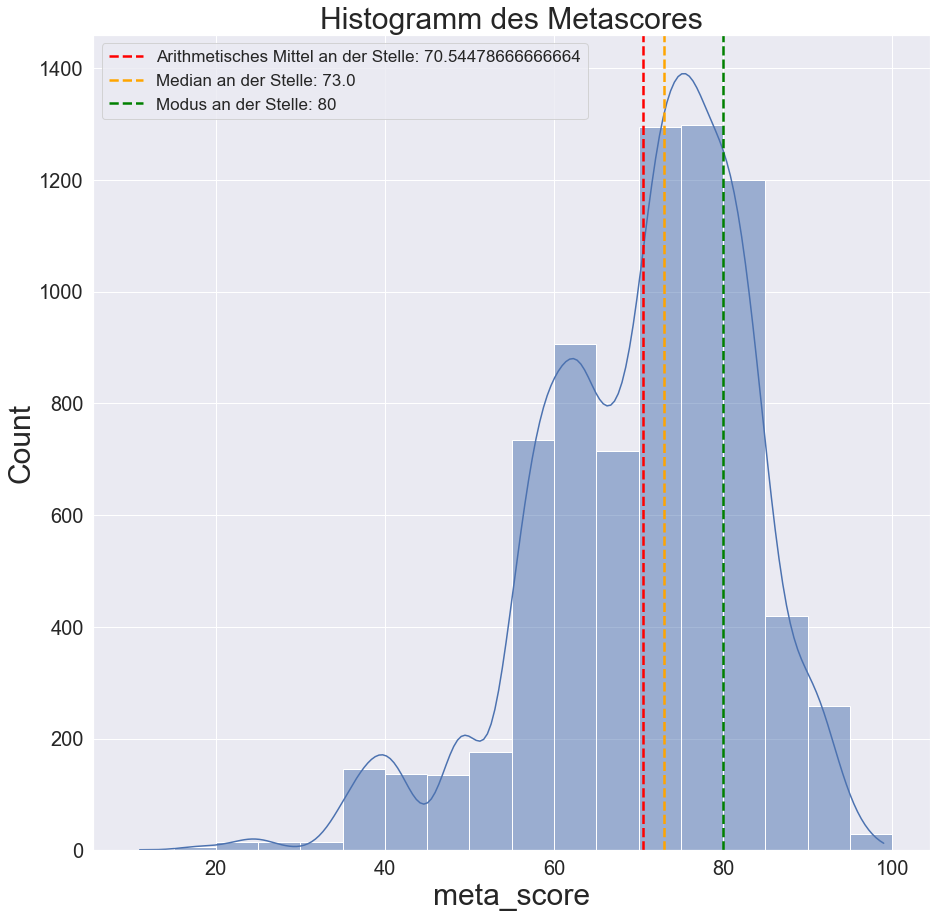

In [56]:
# Erstellt ein Histogram für die meta_score-Spalte
sns.set(rc={'figure.figsize': (15, 15)})  # Setzt die Größe der Grafik fest
# Erstellt Histogram mit einer Balkenbreite von 5 Skalenwerten und einer eingezeichneten Verteilungskurve
sns.histplot(metacrit_data.meta_score, binwidth=5,
             binrange=[10, 100], kde=True)
# Passt den Titel der x-Achse an und dessen größe
plt.xlabel("meta_score", size=30)
plt.ylabel("Count", size=30)  # Passt den Titel der y-Achse an und dessen größe
# Passt die größe der x und y Achse an
plt.tick_params(axis='both', which='major', labelsize=20)
plt.axvline(x=metacrit_data["meta_score"].mean(), color='red', ls='--', lw=2.5, label=("Arithmetisches Mittel an der Stelle: " +
            str(metacrit_data["meta_score"].mean())))  # Erstellt eine Gerade an der Stelle des arithmetischen Mittels
plt.axvline(x=metacrit_data["meta_score"].median(), color='orange', ls='--', lw=2.5, label=(
    "Median an der Stelle: "+str(metacrit_data["meta_score"].median())))  # Erstellt eine Gerade an der Stelle des Medians
# Erstellt eine Gerade an der Stelle des Modus (manuell eingegeben)
plt.axvline(x=80, color='green', ls='--', lw=2.5,
            label="Modus an der Stelle: 80")
plt.legend(loc='upper left', prop={'size': 17})
# Setzt den Titel der Grafik und dessen Größe fest
plt.title("Histogramm des Metascores", size=30)
# Speichert die Grafik in den Pictures-Ordner als .jpg Datei
plt.savefig("Pictures/histogram_metascore.jpg")


In [57]:
# Gibt den Interquartils-Abstand der meta_score-Spalte wieder
stats.iqr(metacrit_data["meta_score"])


17.0

In [58]:
# Berechnung der Grenze des oberen und unteren Whiskers:
IQA = 17
Q3 = 80
Q1 = 63
print("Obere Whisker Grenze: "+str(Q3+(IQA*1.5)))
print("Untere Whisker Grenze: "+str(Q1-(IQA*1.5)))
print("Unterer Grenzwert für Extremwerte: "+str(Q1-(IQA*3)))


Obere Whisker Grenze: 105.5
Untere Whisker Grenze: 37.5
Unterer Grenzwert für Extremwerte: 12


In [59]:
# Gibt die Anzahl an Reihen und damit die Anzahl an Fällen an, die unter den gesetzten Werten liegen
print(metacrit_data[(metacrit_data["meta_score"] < 37.5)].shape)
print(metacrit_data[(metacrit_data["meta_score"] < 12)].shape)


(120, 21)
(1, 21)


##### 3.2.2. Userscore

In [60]:
# Gibt für die unterschiedlichen Spalten mit NUR Zahlenwerten, bestimmte statistische Werte wieder.
metacrit_data.describe()


,meta_score,user_score,niche_width,platform_width,year
count,7500.000000,7500.000000,7500.000000,7500.000000,7500.000000
mean,70.544787,70.402640,3.459600,1.349067,14.493733
std,12.498587,12.898089,1.186489,0.719320,5.493037
min,11.000000,12.000000,1.000000,1.000000,0.000000
25%,63.000000,64.000000,3.000000,1.000000,10.000000
50%,73.000000,73.000000,3.000000,1.000000,14.000000
75%,80.000000,79.550000,4.000000,1.000000,19.000000
max,99.000000,98.000000,10.000000,9.000000,23.000000


In [61]:
# Gibt an wie häufig ein einzigartiger Wert vorkommt. (Hieraus lässt sich der Modus ableiten)
metacrit_data["user_score"].value_counts()


77.0    279
75.0    253
78.0    246
76.0    245
79.0    228
       ... 
81.2      1
89.3      1
79.2      1
63.7      1
70.2      1
Name: user_score, Length: 281, dtype: int64

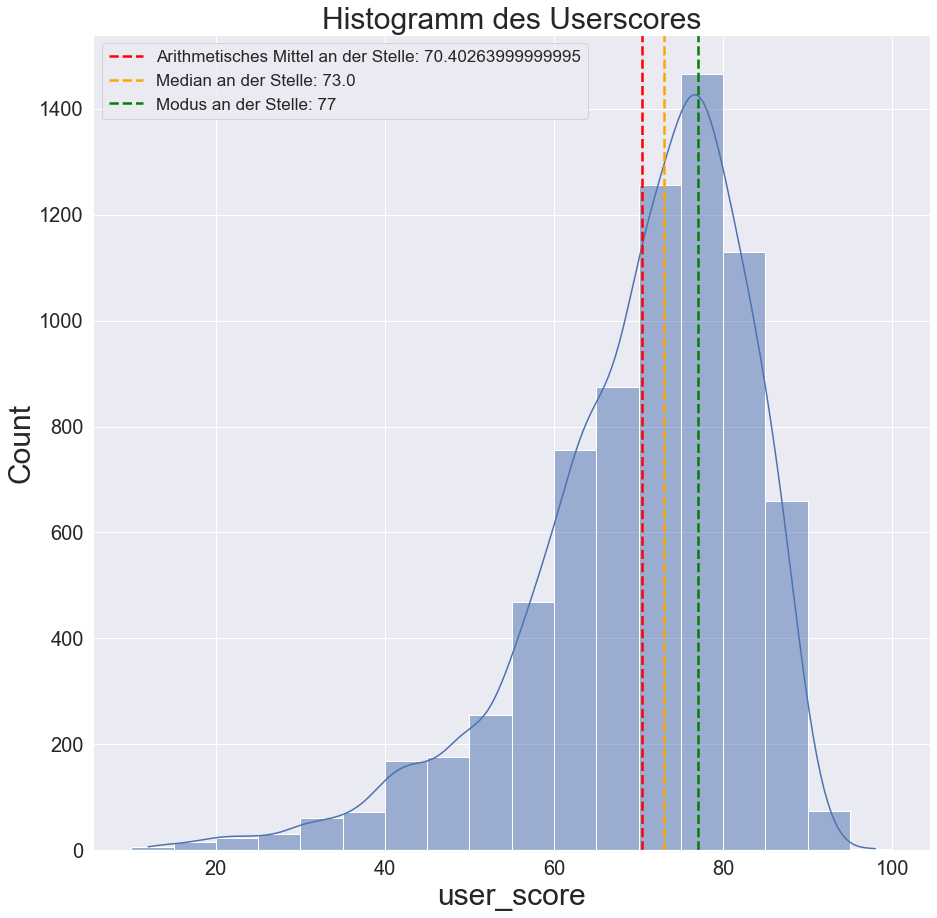

In [62]:
# Erstellt ein Histogram für die user_score-Spalte
sns.set(rc={'figure.figsize': (15, 15)})  # Setzt die Größe der Grafik fest
# Erstellt Histogram mit einer Balkenbreite von 5 Skalenwerten und einer eingezeichneten Verteilungskurve
sns.histplot(metacrit_data.user_score, binwidth=5,
             binrange=[10, 100], kde=True)
# Passt den Titel der x-Achse an und dessen größe
plt.xlabel("user_score", size=30)
plt.ylabel("Count", size=30)  # Passt den Titel der y-Achse an und dessen größe
# Passt die größe der x und y Achse an
plt.tick_params(axis='both', which='major', labelsize=20)
plt.axvline(x=metacrit_data["user_score"].mean(), color='red', ls='--', lw=2.5, label=("Arithmetisches Mittel an der Stelle: " +
            str(metacrit_data["user_score"].mean())))  # Erstellt eine Gerade an der Stelle des arithmetischen Mittels
plt.axvline(x=metacrit_data["user_score"].median(), color='orange', ls='--', lw=2.5, label=(
    "Median an der Stelle: "+str(metacrit_data["user_score"].median())))  # Erstellt eine Gerade an der Stelle des Medians
# Erstellt eine Gerade an der Stelle des Modus (manuell eingegeben)
plt.axvline(x=77, color='green', ls='--', lw=2.5,
            label="Modus an der Stelle: 77")
plt.legend(loc='upper left', prop={'size': 17})
# Setzt den Titel der Grafik und dessen Größe fest
plt.title("Histogramm des Userscores", size=30)
# Speichert die Grafik in den Pictures-Ordner als .jpg Datei
plt.savefig("Pictures/histogram_userscore.jpg")


In [63]:
# Gibt den Interquartils-Abstand der user_score-Spalte wieder
stats.iqr(metacrit_data["user_score"])


15.549999999999997

In [64]:
# Berechnung der Grenze des oberen und unteren Whiskers:
IQA = 16
Q3 = 79
Q1 = 63
print("Obere Whisker Grenze: "+str(Q3+(IQA*1.5)))
print("Untere Whisker Grenze: "+str(Q1-(IQA*1.5)))
print("Unterer Grenzwert für Extremwerte: "+str(Q1-(IQA*3)))


Obere Whisker Grenze: 103.0
Untere Whisker Grenze: 39.0
Unterer Grenzwert für Extremwerte: 15


In [65]:
# Gibt die Anzahl an Reihen und damit die Anzahl an Fällen an, die unter den gesetzten Werten liegen
print(metacrit_data[(metacrit_data["user_score"] < 39)].shape)
print(metacrit_data[(metacrit_data["user_score"] < 15)].shape)


(196, 21)
(7, 21)


##### 3.2.3. Erstellung eines gemeinsamen Boxplots

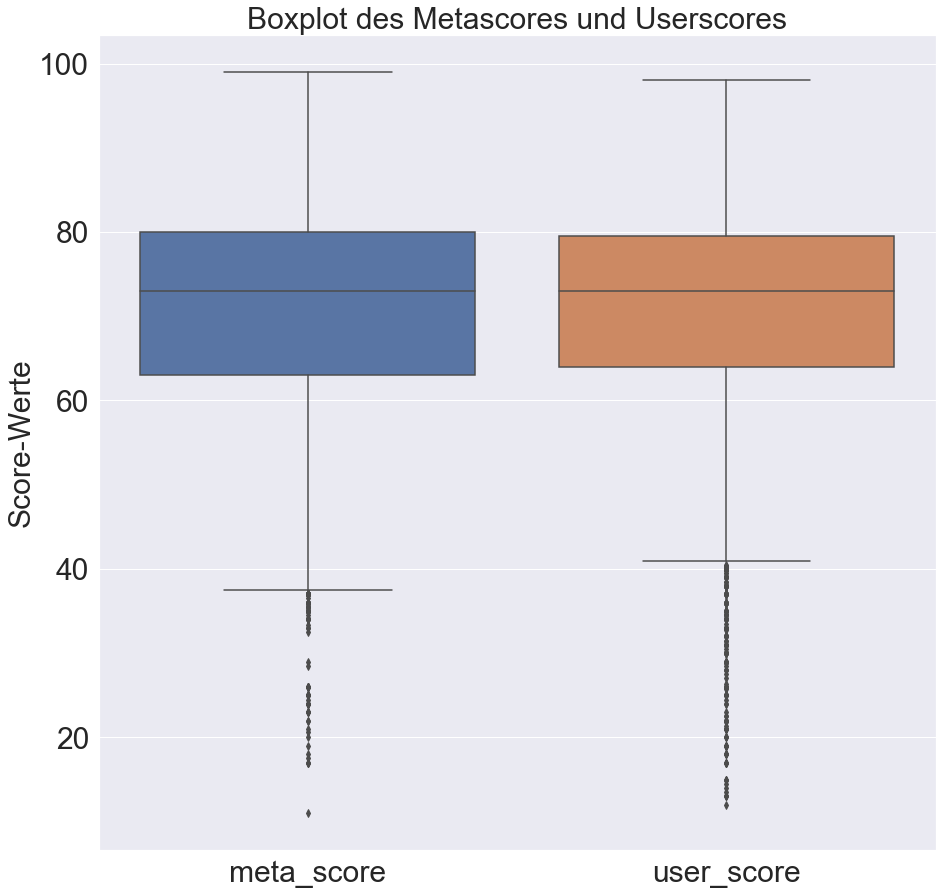

In [66]:
# Erstellt einen Boxplot für meta_score und user_score
sns.boxplot(data=metacrit_data[["meta_score", "user_score"]])
# Passt den Titel der y-Achse an und dessen größe
plt.ylabel("Score-Werte", size=30)
# Passt die größe der x und y Achse an
plt.tick_params(axis='both', which='major', labelsize=30)
# Setzt den Titel der Grafik und dessen Größe fest
plt.title("Boxplot des Metascores und Userscores", size=30)
# Speichert die Grafik in den Pictures-Ordner als .jpg Datei
plt.savefig("Pictures/boxplot_metascore_and_userscore.jpg")


##### 3.2.4: Niche Width

In [67]:
# Gibt für die unterschiedlichen Spalten mit NUR Zahlenwerten, bestimmte statistische Werte wieder.
metacrit_data.describe()


,meta_score,user_score,niche_width,platform_width,year
count,7500.000000,7500.000000,7500.000000,7500.000000,7500.000000
mean,70.544787,70.402640,3.459600,1.349067,14.493733
std,12.498587,12.898089,1.186489,0.719320,5.493037
min,11.000000,12.000000,1.000000,1.000000,0.000000
25%,63.000000,64.000000,3.000000,1.000000,10.000000
50%,73.000000,73.000000,3.000000,1.000000,14.000000
75%,80.000000,79.550000,4.000000,1.000000,19.000000
max,99.000000,98.000000,10.000000,9.000000,23.000000


In [68]:
# Gibt an wie häufig ein einzigartiger Wert vorkommt. (Hieraus lässt sich der Modus ableiten)
metacrit_data["niche_width"].value_counts()


3     2423
2     1794
4     1759
5     1205
6      224
7       72
8       19
9        2
1        1
10       1
Name: niche_width, dtype: int64

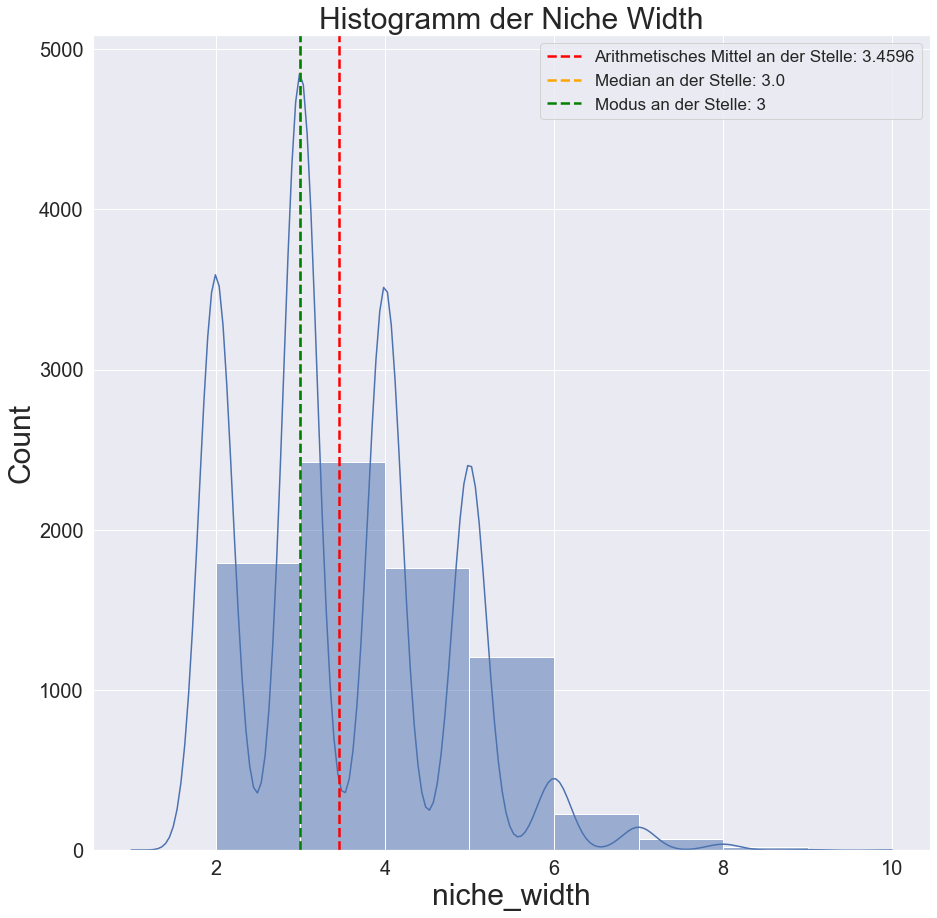

In [69]:
# Erstellt ein Histogram für die niche_width-Spalte
sns.set(rc={'figure.figsize': (15, 15)})  # Setzt die Größe der Grafik fest
# Erstellt Histogram mit einer Balkenbreite von 1 Skalenwerten und einer eingezeichneten Verteilungskurve
sns.histplot(metacrit_data.niche_width, binwidth=1, kde=True)
# Passt den Titel der x-Achse an und dessen größe
plt.xlabel("niche_width", size=30)
plt.ylabel("Count", size=30)  # Passt den Titel der y-Achse an und dessen größe
# Passt die größe der x und y Achse an
plt.tick_params(axis='both', which='major', labelsize=20)
plt.axvline(x=metacrit_data["niche_width"].mean(), color='red', ls='--', lw=2.5, label=("Arithmetisches Mittel an der Stelle: " +
            str(metacrit_data["niche_width"].mean())))  # Erstellt eine Gerade an der Stelle des arithmetischen Mittels
plt.axvline(x=metacrit_data["niche_width"].median(), color='orange', ls='--', lw=2.5, label=(
    "Median an der Stelle: "+str(metacrit_data["niche_width"].median())))  # Erstellt eine Gerade an der Stelle des Medians
# Erstellt eine Gerade an der Stelle des Modus (manuell eingegeben)
plt.axvline(x=3, color='green', ls='--', lw=2.5,
            label="Modus an der Stelle: 3")
plt.legend(loc='upper right', prop={'size': 17})
# Setzt den Titel der Grafik und dessen Größe fest
plt.title("Histogramm der Niche Width", size=30)
# Speichert die Grafik in den Pictures-Ordner als .jpg Datei
plt.savefig("Pictures/histogram_niche_width.jpg")


In [70]:
# Fehlende Werte werden 0 gesetzt um rechnung zu ermöglichen
metacrit_data["niche_width"] = metacrit_data["niche_width"].replace(np.nan, 0)


In [71]:
# Gibt den Interquartils-Abstand der user_score-Spalte wieder
stats.iqr(metacrit_data["niche_width"])


1.0

In [72]:
# 0 wird wieder als fehlender Wert gesetzt
metacrit_data["niche_width"] = metacrit_data["niche_width"].replace(0, np.nan)


In [73]:
# Berechnung der Grenze des oberen und unteren Whiskers:
IQA = 1
Q3 = 4
Q1 = 3
print("Obere Whisker Grenze: "+str(Q3+(IQA*1.5)))
print("Untere Whisker Grenze: "+str(Q1-(IQA*1.5)))
print("Oberer Grenzwert für Extremwerte: "+str(Q3+(IQA*3)))
print("Unterer Grenzwert für Extremwerte: "+str(Q1-(IQA*3)))


Obere Whisker Grenze: 5.5
Untere Whisker Grenze: 1.5
Oberer Grenzwert für Extremwerte: 7
Unterer Grenzwert für Extremwerte: 0


In [74]:
# Gibt die Anzahl an Reihen und damit die Anzahl an Fällen an, die unter den gesetzten Werten liegen
print("Zeigt die Anzahl an oberen Ausreißern an: " +
      str(metacrit_data[(metacrit_data["niche_width"] > 5.5)].shape))
print("Zeigt die Anzahl an oberen Ausreißern an: " +
      str(metacrit_data[(metacrit_data["niche_width"] < 1.5)].shape))
print("Zeigt die Anzahl an oberen Extremwerten an " +
      str(metacrit_data[(metacrit_data["niche_width"] > 7)].shape))


Zeigt die Anzahl an oberen Ausreißern an: (318, 21)
Zeigt die Anzahl an oberen Ausreißern an: (1, 21)
Zeigt die Anzahl an oberen Extremwerten an (22, 21)


##### 3.2.5. Platform Width

In [75]:
# Gibt für die unterschiedlichen Spalten mit NUR Zahlenwerten, bestimmte statistische Werte wieder.
metacrit_data.describe()


,meta_score,user_score,niche_width,platform_width,year
count,7500.000000,7500.000000,7500.000000,7500.000000,7500.000000
mean,70.544787,70.402640,3.459600,1.349067,14.493733
std,12.498587,12.898089,1.186489,0.719320,5.493037
min,11.000000,12.000000,1.000000,1.000000,0.000000
25%,63.000000,64.000000,3.000000,1.000000,10.000000
50%,73.000000,73.000000,3.000000,1.000000,14.000000
75%,80.000000,79.550000,4.000000,1.000000,19.000000
max,99.000000,98.000000,10.000000,9.000000,23.000000


In [76]:
# Gibt an wie häufig ein einzigartiger Wert vorkommt. (Hieraus lässt sich der Modus ableiten)
metacrit_data["platform_width"].value_counts()


1    5681
2    1231
3     433
4     113
5      33
6       6
7       2
9       1
Name: platform_width, dtype: int64

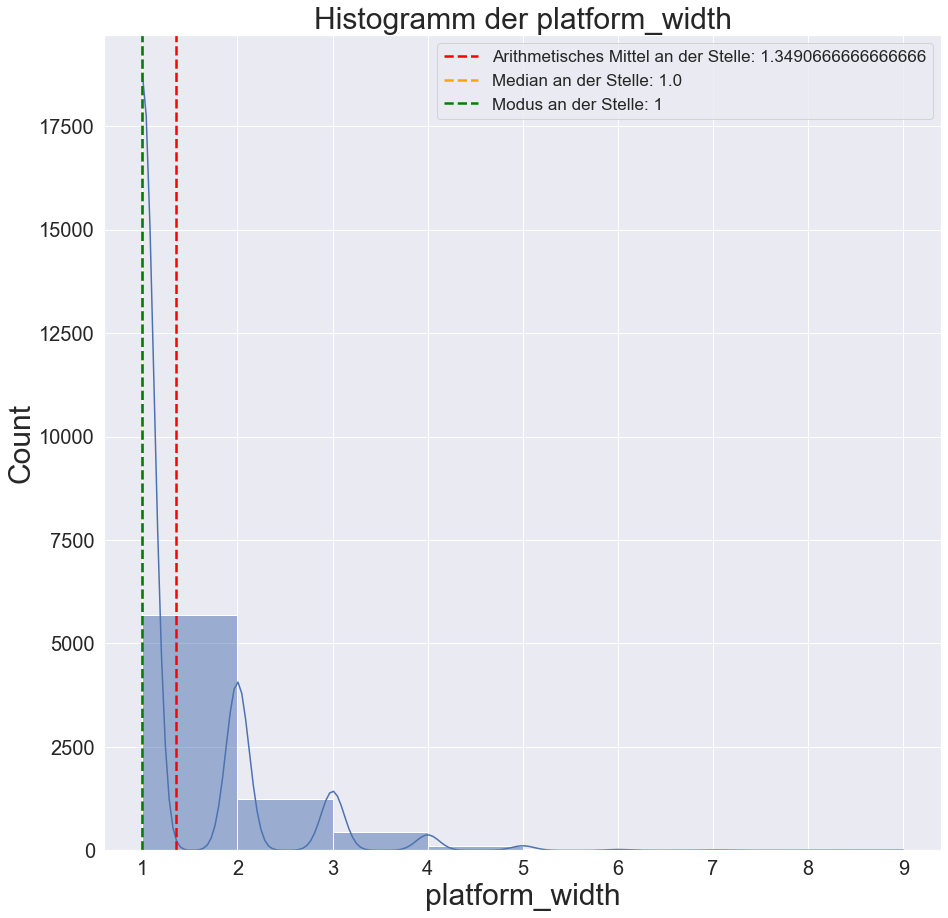

In [77]:
# Erstellt ein Histogram für die platform_width-Spalte
sns.set(rc={'figure.figsize': (15, 15)})  # Setzt die Größe der Grafik fest
# Erstellt Histogram mit einer Balkenbreite von 1 Skalenwerten und einer eingezeichneten Verteilungskurve
sns.histplot(metacrit_data.platform_width, binwidth=1, kde=True)
# Passt den Titel der x-Achse an und dessen größe
plt.xlabel("platform_width", size=30)
plt.ylabel("Count", size=30)  # Passt den Titel der y-Achse an und dessen größe
# Passt die größe der x und y Achse an
plt.tick_params(axis='both', which='major', labelsize=20)
plt.axvline(x=metacrit_data["platform_width"].mean(), color='red', ls='--', lw=2.5, label=("Arithmetisches Mittel an der Stelle: " +
            str(metacrit_data["platform_width"].mean())))  # Erstellt eine Gerade an der Stelle des arithmetischen Mittels
plt.axvline(x=metacrit_data["platform_width"].median(), color='orange', ls='--', lw=2.5, label=(
    "Median an der Stelle: "+str(metacrit_data["platform_width"].median())))  # Erstellt eine Gerade an der Stelle des Medians
# Erstellt eine Gerade an der Stelle des Modus (manuell eingegeben)
plt.axvline(x=1, color='green', ls='--', lw=2.5,
            label="Modus an der Stelle: 1")
plt.legend(loc='upper right', prop={'size': 17})
# Setzt den Titel der Grafik und dessen Größe fest
plt.title("Histogramm der platform_width", size=30)
# Speichert die Grafik in den Pictures-Ordner als .jpg Datei
plt.savefig("Pictures/histogram_platform_width.jpg")


In [78]:
# Gibt den Interquartils-Abstand der user_score-Spalte wieder
stats.iqr(metacrit_data["platform_width"])


0.0

In [79]:
# Berechnung der Grenze des oberen und unteren Whiskers:
IQA = 1
Q3 = 2
Q1 = 1
print("Obere Whisker Grenze: "+str(Q3+(IQA*1.5)))
print("Untere Whisker Grenze: "+str(Q1-(IQA*1.5)))
print("Oberer Grenzwert für Extremwerte: "+str(Q3+(IQA*3)))
print("Unterer Grenzwert für Extremwerte: "+str(Q1-(IQA*3)))


Obere Whisker Grenze: 3.5
Untere Whisker Grenze: -0.5
Oberer Grenzwert für Extremwerte: 5
Unterer Grenzwert für Extremwerte: -2


In [80]:
# Gibt die Anzahl an Reihen und damit die Anzahl an Fällen an, die unter den gesetzten Werten liegen
print("Zeigt die Anzahl an oberen Ausreißern an: " +
      str(metacrit_data[(metacrit_data["platform_width"] > 3.5)].shape))
print("Zeigt die Anzahl an oberen Extremwerten an " +
      str(metacrit_data[(metacrit_data["platform_width"] > 5)].shape))


Zeigt die Anzahl an oberen Ausreißern an: (155, 21)
Zeigt die Anzahl an oberen Extremwerten an (9, 21)


##### 3.2.6. Alter

In [81]:
# Gibt für die unterschiedlichen Spalten mit NUR Zahlenwerten, bestimmte statistische Werte wieder.
metacrit_data.describe()


,meta_score,user_score,niche_width,platform_width,year
count,7500.000000,7500.000000,7500.000000,7500.000000,7500.000000
mean,70.544787,70.402640,3.459600,1.349067,14.493733
std,12.498587,12.898089,1.186489,0.719320,5.493037
min,11.000000,12.000000,1.000000,1.000000,0.000000
25%,63.000000,64.000000,3.000000,1.000000,10.000000
50%,73.000000,73.000000,3.000000,1.000000,14.000000
75%,80.000000,79.550000,4.000000,1.000000,19.000000
max,99.000000,98.000000,10.000000,9.000000,23.000000


In [82]:
# Gibt an wie häufig ein einzigartiger Wert vorkommt. (Hieraus lässt sich der Modus ableiten)
metacrit_data["year"].value_counts()
# .sort_index(ascending=False)


23.0    498
22.0    473
21.0    458
14.0    454
13.0    438
12.0    420
20.0    419
11.0    406
16.0    401
15.0    381
7.0     381
10.0    375
17.0    374
8.0     371
19.0    365
18.0    355
9.0     345
6.0     283
5.0     200
3.0      33
4.0      33
2.0      20
1.0      16
0.0       1
Name: year, dtype: int64

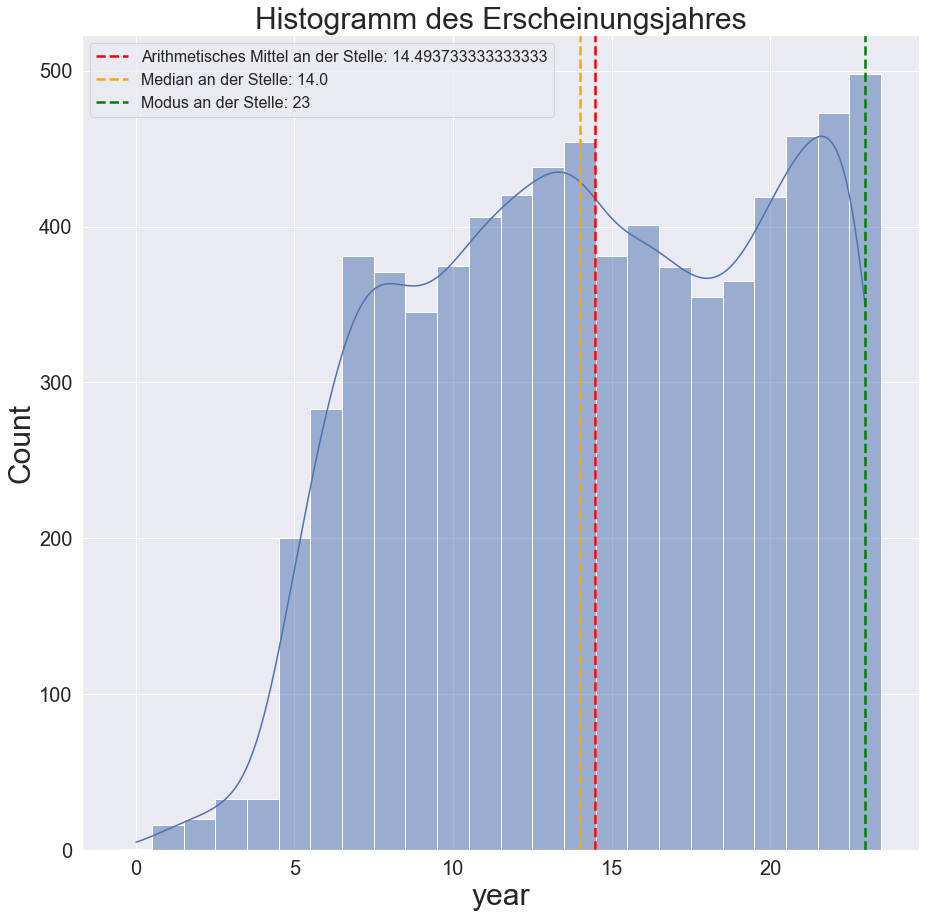

In [83]:
# Erstellt ein Histogram für die year-Spalte
sns.set(rc={'figure.figsize': (15, 15)})  # Setzt die Größe der Grafik fest
# Erstellt Histogram mit einer Balkenbreite von 1 Skalenwerten und einer eingezeichneten Verteilungskurve
sns.histplot(metacrit_data.year, discrete=True, kde=True)
plt.xlabel("year", size=30)  # Passt den Titel der x-Achse an und dessen größe
plt.ylabel("Count", size=30)  # Passt den Titel der y-Achse an und dessen größe
# Passt die größe der x und y Achse an
plt.tick_params(axis='both', which='major', labelsize=20)
plt.axvline(x=metacrit_data["year"].mean(), color='red', ls='--', lw=2.5, label=("Arithmetisches Mittel an der Stelle: " +
            str(metacrit_data["year"].mean())))  # Erstellt eine Gerade an der Stelle des arithmetischen Mittels
plt.axvline(x=metacrit_data["year"].median(), color='orange', ls='--', lw=2.5, label=(
    "Median an der Stelle: "+str(metacrit_data["year"].median())))  # Erstellt eine Gerade an der Stelle des Medians
# Erstellt eine Gerade an der Stelle des Modus (manuell eingegeben)
plt.axvline(x=23, color='green', ls='--', lw=2.5,
            label="Modus an der Stelle: 23")
plt.legend(loc='upper left', prop={'size': 16})
# Setzt den Titel der Grafik und dessen Größe fest
plt.title("Histogramm des Erscheinungsjahres", size=30)
# Speichert die Grafik in den Pictures-Ordner als .jpg Datei
plt.savefig("Pictures/histogram_year.jpg")


In [84]:
# Fehlende Werte werden 0 gesetzt um rechnung zu ermöglichen
metacrit_data.describe()


,meta_score,user_score,niche_width,platform_width,year
count,7500.000000,7500.000000,7500.000000,7500.000000,7500.000000
mean,70.544787,70.402640,3.459600,1.349067,14.493733
std,12.498587,12.898089,1.186489,0.719320,5.493037
min,11.000000,12.000000,1.000000,1.000000,0.000000
25%,63.000000,64.000000,3.000000,1.000000,10.000000
50%,73.000000,73.000000,3.000000,1.000000,14.000000
75%,80.000000,79.550000,4.000000,1.000000,19.000000
max,99.000000,98.000000,10.000000,9.000000,23.000000


In [85]:
# Gibt den Interquartils-Abstand der year-Spalte wieder
print(19-10)


9


In [86]:
# 0 wird wieder als fehlender Wert gesetzt
metacrit_data["year"] = metacrit_data["year"].replace(0, np.nan)


In [87]:
# Berechnung der Grenze des oberen und unteren Whiskers:
IQA = 9
Q3 = 19
Q1 = 10
print("Obere Whisker Grenze: "+str(Q3+(IQA*1.5)))
print("Untere Whisker Grenze: "+str(Q1-(IQA*1.5)))
print("Oberer Grenzwert für Extremwerte: "+str(Q3+(IQA*3)))
print("Unterer Grenzwert für Extremwerte: "+str(Q1-(IQA*3)))


Obere Whisker Grenze: 32.5
Untere Whisker Grenze: -3.5
Oberer Grenzwert für Extremwerte: 46
Unterer Grenzwert für Extremwerte: -17


##### 3.2.7. Names, Genre, Platform, Developer, Publisher, Release date

In [88]:
metacrit_data.columns


Index(['game_name', 'meta_score', 'user_score', 'platform', 'developer',
       'genre', 'publisher', 'release_date', 'genre1', 'genre2', 'genre3',
       'genre4', 'genre5', 'genre6', 'genre7', 'genre8', 'genre9', 'genre10',
       'niche_width', 'platform_width', 'year'],
      dtype='object')

Names:

In [89]:
# Gibt einen Einblick in die Werte, welche in der game_name-Spalte vorhanden sind. (Für mehr infos gesamten Datensatz anzeigen lassen)
metacrit_data["game_name"]


0       The Legend of Zelda: Ocarina of Time
1                         Super Mario Galaxy
2                       Super Mario Galaxy 2
3                              Metroid Prime
4                        Super Mario Odyssey
                        ...                 
7495                             kill.switch
7496                                  nail'd
7497                          oOo: Ascension
7498                            uDraw Studio
7499                                     xXx
Name: game_name, Length: 7500, dtype: object

In [90]:
# Zeigt an, dass es keine Doppelungen bei den Namen gibt
metacrit_data["game_name"].value_counts().unique()


array([1], dtype=int64)

Genres:

In [91]:
# Definiert eine Funktion, welche die Anzahl an Spielen abhängig ihrer Anzahl an Genres wiedergibt
def count_gen_only(n):
    return metacrit_data[(metacrit_data[("genre" + str(n))] != 0) & (metacrit_data["genre"+str(n+1)] == 0)]["game_name"].count()


In [92]:
# Setze die fehlenden Werte in den genre Spalten als 0 fest um Rechnungen zu ermöglichen
x = 1
while x < 11:
    metacrit_data[("genre"+str(x))] = metacrit_data[("genre" +
                                                     str(x))].replace(np.nan, 0)
    x = x+1


In [93]:
# Zeigt auf wie viele Spiele NUR ein bzw. NUR zwei bzw. NUR drei usw. Genres haben
x = 1
while x < 10:
    print("Spiele mit "+str(x)+". Genre: "+str(count_gen_only(x)))
    x = x+1
print("Spiele mit 10. Genre: " +
      str(metacrit_data[(metacrit_data[("genre10")] != 0)]["game_name"].count()))


Spiele mit 1. Genre: 1
Spiele mit 2. Genre: 1794
Spiele mit 3. Genre: 2423
Spiele mit 4. Genre: 1759
Spiele mit 5. Genre: 1205
Spiele mit 6. Genre: 224
Spiele mit 7. Genre: 72
Spiele mit 8. Genre: 19
Spiele mit 9. Genre: 2
Spiele mit 10. Genre: 1


In [94]:
# Setze die 0 in den genre Spalten wieder als fehlenden Wert fest
x = 1
while x < 11:
    metacrit_data[("genre"+str(x))] = metacrit_data[("genre" +
                                                     str(x))].replace(0, np.nan)
    x = x+1


Platform:

In [95]:
# Gibt einen Einblick in die Werte, welche in der platform-Spalte vorhanden sind. (Für mehr infos gesamten Datensatz anzeigen lassen)
metacrit_data["platform"]


0                 ['nintendo-64']
1                         ['wii']
2                         ['wii']
3                    ['gamecube']
4                      ['switch']
                  ...            
7495    ['xbox', 'playstation-2']
7496                       ['pc']
7497                 ['xbox-one']
7498                      ['wii']
7499         ['game-boy-advance']
Name: platform, Length: 7500, dtype: object

Release Date:

In [96]:
# Gibt einen Einblick in die Werte, welche in der release_date-Spalte vorhanden sind. (Für mehr infos gesamten Datensatz anzeigen lassen)
metacrit_data["release_date"]


0       Nov 23, 1998
1       Nov 12, 2007
2       May 23, 2010
3       Nov 17, 2002
4       Oct 27, 2017
            ...     
7495    Oct 28, 2003
7496    Nov 30, 2010
7497    May 25, 2018
7498    Nov 14, 2010
7499    Jul 31, 2002
Name: release_date, Length: 7500, dtype: object

Developer: 

In [97]:
# Gibt einen Einblick in die Werte, welche in der developer-Spalte vorhanden sind. (Für mehr infos gesamten Datensatz anzeigen lassen)
metacrit_data["developer"]


0                  Nintendo
1                  Nintendo
2       Nintendo EAD Tokyo 
3             Retro Studios
4                  Nintendo
               ...         
7495                  Namco
7496               Techland
7497          Kenny Creanor
7498                    THQ
7499        Digital Eclipse
Name: developer, Length: 7500, dtype: object

Publisher:

In [98]:
# Gibt einen Einblick in die Werte, welche in der publisher-Spalte vorhanden sind. (Für mehr infos gesamten Datensatz anzeigen lassen)
metacrit_data["publisher"]


0                 Nintendo
1                 Nintendo
2                 Nintendo
3                 Nintendo
4                 Nintendo
               ...        
7495                 Namco
7496           Deep Silver
7497    Extra Mile Studios
7498                   THQ
7499            Activision
Name: publisher, Length: 7500, dtype: object

# 4. Prüfung der Daten: 

##### 4.1. Erste Analyse

Stata Code:

Nachfolgend werden einige Untersuchungen mithilfe der Statistikanalysesoftware Stata durchgeführt. 
Ob Stata genutzt wird ist an einem "%stata" direkt vor dem Code oder einem "%%stata" am anfang der Code Zelle zu erkennen. Ein einfaches %-Zeichen sagt aus, dass der direkt dort hinterstehende Code von Stata ausgeführt wird. Ein doppeltes %-Zeichen sagt aus, dass der gesamte Code in der jeweiligen Code Zelle von Stata ausgeführt wird, auch wenn vor den einzelnen Code Absätzen kein "%Stata" steht. 

In [99]:
# Erstellt eine Kopie des metacrit_data-Dataframes, welcher an die nachfolgende Untersuchung angepasst werden kann, ohne den Hauptdatensatz zu verändern.
metacrit_data_GeneralOutput1 = metacrit_data.copy()


In [100]:
# Erstellt einen für Stata lesbare Datei mit den eingegebnen Spalten
metacrit_data_GeneralOutput1[["game_name", "meta_score", "user_score", "niche_width",
                              "platform_width", "year", "publisher"]].to_stata('Stata/Stata_Data/stata_data_GeneralOutput1.dta')


-------------------------------------------------------------------------------
      name:  <unnamed>
       log:  c:\Users\Marek\Documents\GitHub\BachelorThesis\Stata/Stata_Output/
> Stata_GeneralOutput1.smcl
  log type:  smcl
 opened on:   8 Feb 2023, 20:43:36


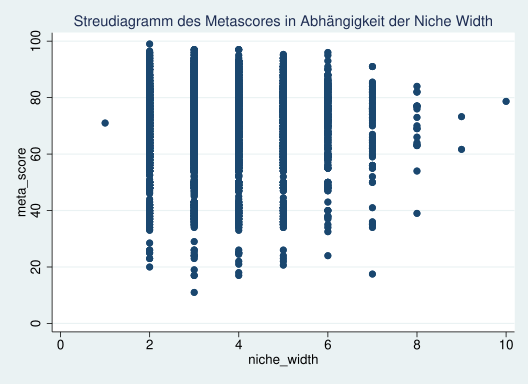

file Pictures/Stata/scatter_meta_niche.png written in PNG format


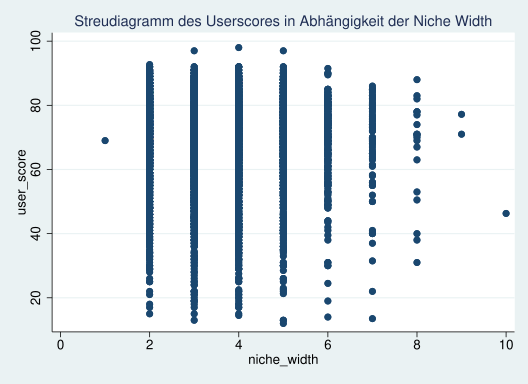

file Pictures/Stata/scatter_user_niche.png written in PNG format

             | meta_s~e user_s~e niche_~h platfo~h     year
-------------+---------------------------------------------
  meta_score |   1.0000 
             |
             |
  user_score |   0.6110*  1.0000 
             |   0.0000
             |
 niche_width |   0.0199  -0.0655*  1.0000 
             |   0.0846   0.0000
             |
platform_w~h |   0.1104*  0.0078   0.0325*  1.0000 
             |   0.0000   0.4984   0.0049
             |
        year |   0.0079  -0.2155* -0.0466*  0.0487*  1.0000 
             |   0.4950   0.0000   0.0001   0.0000
             |

Skewness and kurtosis tests for normality
                                                         ----- Joint test -----
    Variable |       Obs   Pr(skewness)   Pr(kurtosis)   Adj chi2(2)  Prob>chi2
-------------+-----------------------------------------------------------------
  meta_score |     7,500         0.0000         0.0000        602.51     0.0

In [101]:
# METASCORE und USERSCORE:

# Erstellt eine Log-Datei, welche den Stata Output abspeichert
%stata log using Stata/Stata_Output/Stata_GeneralOutput1, replace

# Liest den erstellten Datensatz in Stata ein
%stata use Stata/Stata_Data/stata_data_GeneralOutput1

# Erstellt ein Streudiagramm mit dem Metascore als abhängige Variable und der Niche Width als unabhängige Variable
%stata scatter meta_score niche_width, title(Streudiagramm des Metascores in Abhängigkeit der Niche Width, size(medium))
# Speichert die Grafik als jpg-Datei
%stata graph export Pictures/Stata/scatter_meta_niche.png, width(3840) replace

# Erstellt ein Streudiagramm mit dem Uetascore als abhängige Variable und der Niche Width als unabhängige Variable
%stata scatter user_score niche_width, title(Streudiagramm des Userscores in Abhängigkeit der Niche Width, size(medium))
# Speichert die Grafik als jpg-Datei
%stata graph export Pictures/Stata/scatter_user_niche.png, width(3840) replace

# Erstellt eine Korrelations-Matrix
%stata pwcorr meta_score user_score niche_width platform_width year, sig star(0.05)

# Überprüft ob die Schiefe der Variablen in einem aktzeptablen Bereich liegen, sodass die Annahme der Normalverteilung nicht verletzt wäre
%stata sktest meta_score
%stata sktest user_score

# Beendet das Log
%stata log close
# Schreibt den Stata Output in eine PDF-Datei um eine einfache Betrachtung zu ermöglichen
%stata translate Stata/Stata_Output/Stata_GeneralOutput1.smcl Stata/Stata_Output/Stata_GeneralOutput1.pdf
%stata clear


-------------------------------------------------------------------------------
      name:  <unnamed>
       log:  c:\Users\Marek\Documents\GitHub\BachelorThesis\Stata/Stata_Output/
> Stata_Output_restest1.smcl
  log type:  smcl
 opened on:   8 Feb 2023, 20:43:45
*******************************************************************************
> ***
************ Metascore First Regress ******************************************
> ***
*******************************************************************************
> ***

      Source |       SS           df       MS      Number of obs   =     7,499
-------------+----------------------------------   F(3, 7495)      =     31.63
       Model |  14643.0809         3  4881.02697   Prob > F        =    0.0000
    Residual |  1156571.85     7,495  154.312455   R-squared       =    0.0125
-------------+----------------------------------   Adj R-squared   =    0.0121
       Total |  1171214.93     7,498  156.203645   Root MSE        =    12.422

-

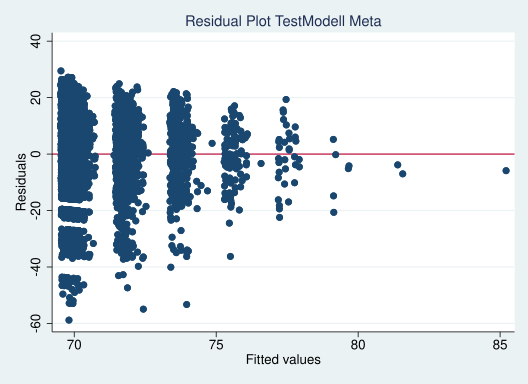

file Pictures/Stata/rvfplot_meta_first.png written in PNG format
************ Metascore First Regress sktest ***********************************
> ****
(1 missing value generated)

Skewness and kurtosis tests for normality
                                                         ----- Joint test -----
    Variable |       Obs   Pr(skewness)   Pr(kurtosis)   Adj chi2(2)  Prob>chi2
-------------+-----------------------------------------------------------------
    res_meta |     7,499         0.0000         0.0000        596.96     0.0000
*******************************************************************************
> ***
************ Userscore First Regress ******************************************
> ***
*******************************************************************************
> ***

      Source |       SS           df       MS      Number of obs   =     7,499
-------------+----------------------------------   F(3, 7495)      =    138.62
       Model |  65568.8989         3  21

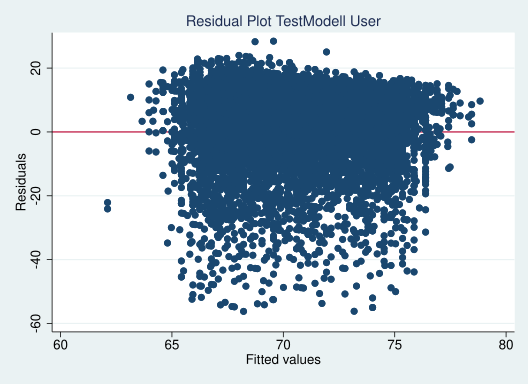

file Pictures/Stata/rvfplot_user_first.png written in PNG format
************ Userscore First Regress sktest ***********************************
> ***
(1 missing value generated)

Skewness and kurtosis tests for normality
                                                         ----- Joint test -----
    Variable |       Obs   Pr(skewness)   Pr(kurtosis)   Adj chi2(2)  Prob>chi2
-------------+-----------------------------------------------------------------
    res_user |     7,499         0.0000         0.0000             .          .
(bin=38, start=-58.814426, width=2.3231978)


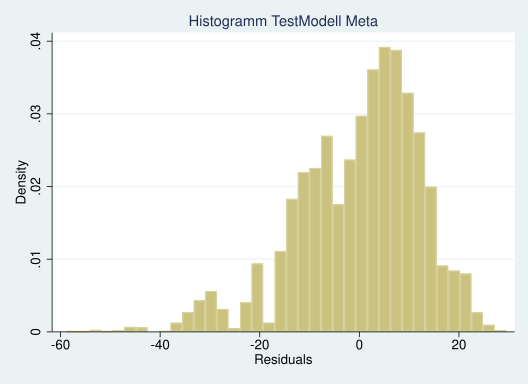

file Pictures/Stata/histo_res_meta.png written in PNG format
(bin=38, start=-56.214878, width=2.2277524)


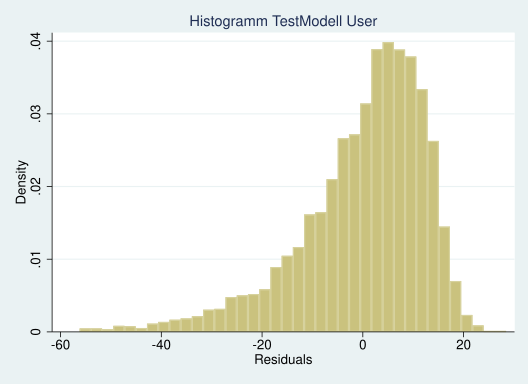

file Pictures/Stata/histo_res_user.png written in PNG format
      name:  <unnamed>
       log:  c:\Users\Marek\Documents\GitHub\BachelorThesis\Stata/Stata_Output/
> Stata_Output_restest1.smcl
  log type:  smcl
 closed on:   8 Feb 2023, 20:43:55
-------------------------------------------------------------------------------
file Stata/Stata_Output/_restest1.pdf saved as PDF format


In [102]:
# METASCORE und USERSCORE:

# Erstellt eine Log-Datei, welche den Stata Output abspeichert
%stata log using Stata/Stata_Output/Stata_Output_restest1, replace

# Liest den erstellten Datensatz in Stata ein
%stata use Stata/Stata_Data/stata_data_GeneralOutput1

%stata di "**********************************************************************************"
%stata di "************ Metascore First Regress *********************************************"
%stata di "**********************************************************************************"
%stata regress meta_score niche_width platform_width year
%stata di "************ VIF Tabelle *******************************************************"
%stata vif
%stata rvfplot, yline(0) title(Residual Plot TestModell Meta, size(medium))
%stata graph export Pictures/Stata/rvfplot_meta_first.png, width(3840) replace
%stata di "************ Metascore First Regress sktest ***************************************"
%stata predict res_meta, resid
%stata sktest res_meta

%stata di "**********************************************************************************"
%stata di "************ Userscore First Regress *********************************************"
%stata di "**********************************************************************************"
%stata regress user_score niche_width platform_width year
%stata di "************ VIF Tabelle *******************************************************"
%stata vif
%stata rvfplot, yline(0) title(Residual Plot TestModell User, size(medium))
%stata graph export Pictures/Stata/rvfplot_user_first.png, width(3840) replace
%stata di "************ Userscore First Regress sktest **************************************"
%stata predict res_user, resid
%stata sktest res_user

%stata histogram res_meta, title(Histogramm TestModell Meta, size(medium))
%stata graph export Pictures/Stata/histo_res_meta.png, width(3840) replace
%stata histogram res_user, title(Histogramm TestModell User, size(medium))
%stata graph export Pictures/Stata/histo_res_user.png, width(3840) replace
# Beendet das Log
%stata log close
# Schreibt den Stata Output in eine PDF-Datei um eine einfache Betrachtung zu ermöglichen
%stata translate Stata/Stata_Output/Stata_Output_restest1.smcl Stata/Stata_Output/_restest1.pdf
%stata clear


##### Mittelwerte pro möglicher Genre-Anzahl

In [103]:
# Setze die Missing Values in den genre Spalten als 0 fest um Rechnungen zu ermöglichen
x = 1
while x < 11:
    metacrit_data[("genre"+str(x))] = metacrit_data[("genre" +
                                                     str(x))].replace(np.nan, 0)
    x = x+1


In [104]:
# Diese Funktionen geben das aritmethische Mittel oder den Median des Metascores bzw. Userscores in Abhänigkeit der Genre-Anzahl wieder.

# Funktion für arithmetisches Mittel abhängig von der Genre Anzahl:
def mean_gen_only_meta(n):
    return metacrit_data[(metacrit_data[("genre" + str(n))] != 0) & (metacrit_data["genre"+str(n+1)] == 0)]["meta_score"].mean()

# Funktion für arithmetisches Mittel abhängig von der Genre Anzahl


def median_gen_only_meta(n):
    return metacrit_data[(metacrit_data[("genre" + str(n))] != 0) & (metacrit_data["genre"+str(n+1)] == 0)]["meta_score"].median()

# Funktion für arithmetisches Mittel abhängig von der Genre Anzahl


def mean_gen_only_user(n):
    return metacrit_data[(metacrit_data[("genre" + str(n))] != 0) & (metacrit_data["genre"+str(n+1)] == 0)]["user_score"].mean()

# Funktion für arithmetisches Mittel abhängig von der Genre Anzahl


def median_gen_only_user(n):
    return metacrit_data[(metacrit_data[("genre" + str(n))] != 0) & (metacrit_data["genre"+str(n+1)] == 0)]["user_score"].median()


In [105]:
# Gibt das aritmethische Mittel des Meta Scores für jede Genre-Anzahl an.
x = 1
while x < 10:
    print("Spiele mit " + str(x), "Genre: ", mean_gen_only_meta(x))
    x = x+1
print("Spiele mit 10 Genre: " +
      str(metacrit_data[(metacrit_data["genre10"] != 0)]["meta_score"].mean()))


Spiele mit 1 Genre:  71.0
Spiele mit 2 Genre:  69.88476031215163
Spiele mit 3 Genre:  70.57367313248041
Spiele mit 4 Genre:  70.90470722001137
Spiele mit 5 Genre:  71.22356846473029
Spiele mit 6 Genre:  70.03165178571429
Spiele mit 7 Genre:  67.63666666666667
Spiele mit 8 Genre:  69.75421052631579
Spiele mit 9 Genre:  67.46000000000001
Spiele mit 10 Genre: 78.67


In [106]:
# Gibt den Median des Meta Scores für jede Genre-Anzahl an.
x = 1
while x < 10:
    print("genre" + str(x), ": ", median_gen_only_meta(x))
    x = x+1
print("genre10 : " +
      str(metacrit_data[(metacrit_data["genre10"] != 0)]["meta_score"].median()))


genre1 :  71.0
genre2 :  72.0
genre3 :  72.0
genre4 :  73.67
genre5 :  74.0
genre6 :  73.0
genre7 :  72.75
genre8 :  70.0
genre9 :  67.46000000000001
genre10 : 78.67


In [107]:
# Gibt das aritmethische Mittel des User Scores für jede Genre-Anzahl an.
x = 1
while x < 10:
    print("genre" + str(x), ": ", mean_gen_only_user(x))
    x = x+1
print("genre10 : " +
      str(metacrit_data[(metacrit_data["genre10"] != 0)]["user_score"].mean()))


genre1 :  69.0
genre2 :  71.3289855072464
genre3 :  70.87362773421374
genre4 :  69.80198976691302
genre5 :  69.64265560165974
genre6 :  68.20089285714288
genre7 :  67.125
genre8 :  66.01052631578948
genre9 :  74.1
genre10 : 46.3


In [108]:
# Gibt den Median des User Scores für jede Genre-Anzahl an.
x = 1
while x < 10:
    print("genre" + str(x), ": ", median_gen_only_user(x))
    x = x+1
print("genre10 : " +
      str(metacrit_data[(metacrit_data["genre10"] != 0)]["user_score"].median()))


genre1 :  69.0
genre2 :  73.7
genre3 :  73.0
genre4 :  73.0
genre5 :  72.0
genre6 :  72.0
genre7 :  69.75
genre8 :  70.7
genre9 :  74.1
genre10 : 46.3


In [109]:
# Setze die 0 in den genre Spalten wieder als fehlenden Wert
x = 1
while x < 11:
    metacrit_data[("genre"+str(x))] = metacrit_data[("genre" +
                                                     str(x))].replace(0, np.nan)
    x = x+1


##### Genrelisten


In [110]:
# Erstellt von jeder genre Spalte eine Liste mit den einzigartigen Genres der jeweiligen Spalte
genre1_list = metacrit_data["genre1"].unique().tolist()
genre2_list = metacrit_data["genre2"].unique().tolist()
genre3_list = metacrit_data["genre3"].unique().tolist()
genre4_list = metacrit_data["genre4"].unique().tolist()
genre5_list = metacrit_data["genre5"].unique().tolist()
genre6_list = metacrit_data["genre6"].unique().tolist()
genre7_list = metacrit_data["genre7"].unique().tolist()
genre8_list = metacrit_data["genre8"].unique().tolist()
genre9_list = metacrit_data["genre9"].unique().tolist()
genre10_list = metacrit_data["genre10"].unique().tolist()


In [111]:
# Erstellt aus den einzelnen Listen eine einzige Liste, bei der jedes einzigartige Genre nur einmal aufgelistet wird.
list_of_unique_genres = sorted(np.unique(genre1_list+genre2_list+genre3_list+genre4_list +
                               genre5_list+genre6_list+genre7_list+genre8_list+genre9_list+genre10_list))
list_of_unique_genres.remove("nan")
list_of_unique_genres


['"Beat-Em-Up"',
 '"Shoot-Em-Up"',
 '2D',
 '3D',
 '4X',
 'Action',
 'ActionAdventure',
 'ActionRPG',
 'Adventure',
 'Alternative',
 'Application',
 'Arcade',
 'Artillery',
 'Athletics',
 'Automobile',
 'Baseball',
 'Basketball',
 'Biking',
 'Billiards',
 'Board/CardGame',
 'BoardGames',
 'Bowling',
 'Boxing',
 'Boxing/MartialArts',
 'Breeding/Constructing',
 'Business/Tycoon',
 'CarCombat',
 'CardBattle',
 'Career',
 'CityBuilding',
 'Civilian',
 'CivilianPlane',
 'Combat',
 'Command',
 'Compilation',
 'Console-styleRPG',
 'Cricket',
 'Dancing',
 'Defense',
 'DemolitionDerby',
 'Drag',
 'Driving',
 'Edutainment',
 'Exercise/Fitness',
 'Fantasy',
 'Fighting',
 'First-Person',
 'Fishing',
 'Flight',
 'Football',
 'FormulaOne',
 'Futuristic',
 'FuturisticJet',
 'FuturisticSub',
 'GT/Street',
 'Gambling',
 'General',
 'Golf',
 'Government',
 'Helicopter',
 'HiddenObject',
 'Historic',
 'Horizontal',
 'Horror',
 'HorseRacing',
 'Hunting',
 'IceHockey',
 'Individual',
 'InteractiveMovie',
 '

In [112]:
# Gibt die Länge der Genre Liste wieder
len(list_of_unique_genres)


168

In [113]:
# Gibt die Position des eigegebenen Genres ("Tank") wieder
list_of_unique_genres.index("Tank")


142

In [114]:
# Gibt das Genre an der eingegebenen Position (142) wieder
list_of_unique_genres[142]


'Tank'

In [115]:
# Erstellt 2 leere DataFrames, welche mit Werten "befüllt" werden können
data = {'genre': [],
        "count": [],
        'score_mean': [],
        'standard_deviation': [],
        'score_median': [],
        "nw_mean": [],
        "pw_mean": [],
        "y_mean": [], }

genre_meta_df = pd.DataFrame(data)
genre_user_df = pd.DataFrame(data)


In [116]:
metacrit_data["meta_score"].count()


7500

In [117]:
# Überträgt das Arithmetische Mittel und den Median des MetaScores je Genre (über 30 Fälle) in einen gesonderten DataFrame
x = 1
while x < len(list_of_unique_genres):
    temp_df = metacrit_data[(metacrit_data["genre1"] == list_of_unique_genres[x]) | (metacrit_data["genre2"] == list_of_unique_genres[x]) | (metacrit_data["genre3"] == list_of_unique_genres[x]) | (metacrit_data["genre4"] == list_of_unique_genres[x]) | (metacrit_data["genre5"] == list_of_unique_genres[x]) | (metacrit_data["genre6"] == list_of_unique_genres[x]) | (metacrit_data["genre7"] == list_of_unique_genres[x]) | (
        metacrit_data["genre8"] == list_of_unique_genres[x]) | (metacrit_data["genre9"] == list_of_unique_genres[x]) | (metacrit_data["genre10"] == list_of_unique_genres[1])]  # Erstellt einen temporären DataFrame, welcher jeden Fall abspeichert, der ein bestimmtes Genre in einer der Genrespalten enthält. (Kurzzeitig entsteht somit ein Dataframe mit allen Spielen, die das Genre Action enthalten)
    if len(temp_df) > 30:
        genre_meta_df.loc[x, ["genre", "count", "score_mean", "standard_deviation", "score_median", "nw_mean", "pw_mean", "y_mean"]] = [list_of_unique_genres[x], (temp_df["meta_score"].count(
        )), (temp_df["meta_score"].mean()), (temp_df["meta_score"].std()), (temp_df["meta_score"].median()), (temp_df["niche_width"].mean()), (temp_df["platform_width"].mean()), (temp_df["year"].mean())]
        #print("Median für Genre " +str(list_of_unique_genres[x]) + ": " + str(temp_df["meta_score"].median()) )
        #print("Arithmetisches Mittel für Genre " +str(list_of_unique_genres[x]) + ": " + str(temp_df["meta_score"].mean()) )
    x = x+1
genre_meta_df


,genre,count,score_mean,standard_deviation,score_median,nw_mean,pw_mean,y_mean
1,"""Shoot-Em-Up""",177.0,71.345141,10.398188,74.0,5.096045,1.248588,17.276836
2,2D,608.0,72.057516,11.890250,74.5,3.384868,1.320724,16.264803
3,3D,610.0,69.162410,12.454487,70.0,3.678689,1.368852,14.652459
4,4X,33.0,79.553030,11.471731,80.0,3.939394,1.121212,14.969697
5,Action,2736.0,69.612957,12.878837,72.0,3.804094,1.370980,15.042398
...,...,...,...,...,...,...,...,...
158,Virtual,98.0,70.290816,9.640625,71.5,4.183673,1.224490,15.510204
159,VirtualLife,74.0,70.806351,9.858835,73.0,3.959459,1.202703,14.027027
160,VisualNovel,35.0,72.495143,10.657513,75.0,2.800000,1.342857,19.657143
166,Western-Style,104.0,75.738750,11.628261,78.0,2.980769,1.307692,15.076923


In [118]:
genre_meta_df.sort_values("standard_deviation")


,genre,count,score_mean,standard_deviation,score_median,nw_mean,pw_mean,y_mean
80,Matching,52.0,73.322308,7.545244,74.0,3.326923,1.230769,12.711538
58,Government,41.0,73.524390,7.810211,75.0,4.487805,1.146341,14.951220
103,Point-and-Click,155.0,73.201548,8.928565,74.0,3.490323,1.387097,17.754839
15,Baseball,62.0,75.249839,9.610210,77.5,4.435484,1.451613,12.419355
158,Virtual,98.0,70.290816,9.640625,71.5,4.183673,1.224490,15.510204
...,...,...,...,...,...,...,...,...
9,Alternative,92.0,67.679022,14.452509,70.5,3.858696,1.565217,10.054348
96,PC-styleRPG,42.0,72.801667,14.566230,75.0,3.261905,1.142857,11.023810
88,Motorcycle,41.0,65.841463,15.378329,69.0,5.024390,1.390244,11.390244
99,Party/Minigame,65.0,60.569231,15.403905,62.0,3.215385,1.046154,16.507692


In [119]:
# Überträgt das Arithmetische Mittel und den Median des UserScores je Genre (über 30 Fälle) in einen gesonderten DataFrame
x = 1
while x < len(list_of_unique_genres):
    temp_df = metacrit_data[(metacrit_data["genre1"] == list_of_unique_genres[x]) | (metacrit_data["genre2"] == list_of_unique_genres[x]) | (metacrit_data["genre3"] == list_of_unique_genres[x]) | (metacrit_data["genre4"] == list_of_unique_genres[x]) | (metacrit_data["genre5"] == list_of_unique_genres[x]) | (
        metacrit_data["genre6"] == list_of_unique_genres[x]) | (metacrit_data["genre7"] == list_of_unique_genres[x]) | (metacrit_data["genre8"] == list_of_unique_genres[x]) | (metacrit_data["genre9"] == list_of_unique_genres[x]) | (metacrit_data["genre10"] == list_of_unique_genres[1])]
    if len(temp_df) > 30:
        genre_user_df.loc[x, ["genre", "count", "score_mean", "standard_deviation", "score_median", "nw_mean", "pw_mean", "y_mean"]] = [list_of_unique_genres[x], (temp_df["meta_score"].count(
        )), (temp_df["user_score"].mean()), (temp_df["user_score"].std()), (temp_df["user_score"].median()), (temp_df["niche_width"].mean()), (temp_df["platform_width"].mean()), (temp_df["year"].mean())]
        #print("Median für Genre " +str(list_of_unique_genres[x]) + ": " + str(temp_df["user_score"].median()) )
        #print("Arithmetisches Mittel für Genre " +str(list_of_unique_genres[x]) + ": " + str(temp_df["user_score"].mean()) )
    x = x+1
genre_user_df


,genre,count,score_mean,standard_deviation,score_median,nw_mean,pw_mean,y_mean
1,"""Shoot-Em-Up""",177.0,69.976836,10.062067,72.00,5.096045,1.248588,17.276836
2,2D,608.0,71.390461,11.710577,73.50,3.384868,1.320724,16.264803
3,3D,610.0,70.499508,12.599844,72.35,3.678689,1.368852,14.652459
4,4X,33.0,73.721212,14.555578,77.00,3.939394,1.121212,14.969697
5,Action,2736.0,69.765497,13.006008,72.00,3.804094,1.370980,15.042398
...,...,...,...,...,...,...,...,...
158,Virtual,98.0,67.229592,12.499222,71.00,4.183673,1.224490,15.510204
159,VirtualLife,74.0,67.128378,13.339256,71.50,3.959459,1.202703,14.027027
160,VisualNovel,35.0,74.291429,11.795522,75.00,2.800000,1.342857,19.657143
166,Western-Style,104.0,73.261538,11.983802,76.00,2.980769,1.307692,15.076923


In [120]:
genre_meta_df.sort_values("score_mean")


,genre,count,score_mean,standard_deviation,score_median,nw_mean,pw_mean,y_mean
98,Party,50.0,58.270000,16.388526,59.00,3.080000,1.080000,12.780000
99,Party/Minigame,65.0,60.569231,15.403905,62.00,3.215385,1.046154,16.507692
95,Other,47.0,64.535532,12.909482,64.67,4.723404,1.340426,13.808511
72,LightGun,38.0,64.552632,11.424718,66.50,3.736842,1.000000,16.789474
84,Mission-based,35.0,64.742857,11.137039,64.00,3.342857,1.685714,10.000000
...,...,...,...,...,...,...,...,...
128,Soccer,91.0,76.413626,10.684305,78.50,4.571429,1.967033,14.032967
49,Football,74.0,76.556351,10.310129,78.25,4.500000,1.918919,11.297297
118,Sim,271.0,76.657417,9.923670,79.00,4.509225,1.915129,11.904059
66,IceHockey,41.0,76.910488,9.674839,79.00,4.560976,1.463415,12.317073


In [121]:
genre_meta_df.sort_values("score_median")


,genre,count,score_mean,standard_deviation,score_median,nw_mean,pw_mean,y_mean
98,Party,50.0,58.270000,16.388526,59.00,3.080000,1.080000,12.780000
99,Party/Minigame,65.0,60.569231,15.403905,62.00,3.215385,1.046154,16.507692
84,Mission-based,35.0,64.742857,11.137039,64.00,3.342857,1.685714,10.000000
154,Tycoon,44.0,65.011364,12.608823,64.50,3.977273,1.068182,10.909091
95,Other,47.0,64.535532,12.909482,64.67,4.723404,1.340426,13.808511
...,...,...,...,...,...,...,...,...
49,Football,74.0,76.556351,10.310129,78.25,4.500000,1.918919,11.297297
128,Soccer,91.0,76.413626,10.684305,78.50,4.571429,1.967033,14.032967
66,IceHockey,41.0,76.910488,9.674839,79.00,4.560976,1.463415,12.317073
118,Sim,271.0,76.657417,9.923670,79.00,4.509225,1.915129,11.904059


In [122]:
genre_user_df.sort_values("score_mean")


,genre,count,score_mean,standard_deviation,score_median,nw_mean,pw_mean,y_mean
99,Party/Minigame,65.0,62.776923,14.585157,66.0,3.215385,1.046154,16.507692
98,Party,50.0,63.240000,16.058643,67.5,3.080000,1.080000,12.780000
72,LightGun,38.0,63.447368,15.836491,67.0,3.736842,1.000000,16.789474
143,Team,196.0,64.883673,13.305597,69.0,4.795918,1.693878,15.821429
67,Individual,163.0,65.002454,13.557140,67.0,4.693252,1.447853,15.165644
...,...,...,...,...,...,...,...,...
132,Static,31.0,74.677419,8.780232,77.0,5.225806,1.161290,14.000000
69,Japanese-Style,135.0,74.716296,9.643312,76.0,3.037037,1.155556,17.555556
33,Command,40.0,75.025000,13.273238,77.5,4.400000,1.025000,11.775000
34,Compilation,159.0,75.769811,10.684810,78.0,3.301887,1.415094,15.477987


In [123]:
genre_user_df.sort_values("score_median")


,genre,count,score_mean,standard_deviation,score_median,nw_mean,pw_mean,y_mean
99,Party/Minigame,65.0,62.776923,14.585157,66.0,3.215385,1.046154,16.507692
72,LightGun,38.0,63.447368,15.836491,67.0,3.736842,1.000000,16.789474
67,Individual,163.0,65.002454,13.557140,67.0,4.693252,1.447853,15.165644
98,Party,50.0,63.240000,16.058643,67.5,3.080000,1.080000,12.780000
155,Vehicle,43.0,65.390698,13.674687,68.0,4.604651,1.139535,15.976744
...,...,...,...,...,...,...,...,...
33,Command,40.0,75.025000,13.273238,77.5,4.400000,1.025000,11.775000
37,Dancing,39.0,72.994872,10.759010,78.0,3.538462,1.128205,13.615385
63,Horror,137.0,73.333577,13.196887,78.0,3.065693,1.474453,12.927007
34,Compilation,159.0,75.769811,10.684810,78.0,3.301887,1.415094,15.477987


In [124]:
genre_user_df.sort_values("count")


,genre,count,score_mean,standard_deviation,score_median,nw_mean,pw_mean,y_mean
132,Static,31.0,74.677419,8.780232,77.0,5.225806,1.161290,14.000000
4,4X,33.0,73.721212,14.555578,77.0,3.939394,1.121212,14.969697
27,CardBattle,33.0,66.554545,15.819136,69.0,3.575758,1.212121,14.848485
160,VisualNovel,35.0,74.291429,11.795522,75.0,2.800000,1.342857,19.657143
129,Space,35.0,69.134286,13.131080,72.0,4.885714,1.085714,12.742857
...,...,...,...,...,...,...,...,...
83,Miscellaneous,878.0,70.267084,12.383992,73.0,3.380410,1.238041,14.154897
6,ActionAdventure,962.0,71.226195,13.006388,73.5,3.117464,1.569647,15.654886
117,Shooter,972.0,68.815535,14.309292,72.0,4.860082,1.411523,14.374486
56,General,2099.0,68.950310,12.724838,72.0,3.392568,1.276322,15.790753


In [125]:
genre_user_df["count"].mean()


277.5730337078652

# 5. Mehr Drittvariablen

### 5.1. Top 10 Genres

In [126]:
# Erstellt eine Liste mit den Top 10 Genres nach dem durchschnittlichen Metascore
top10_meta_genres = ((genre_meta_df.sort_values(
    "score_mean", ascending=False)).head(n=10))["genre"].tolist()
top10_meta_genres


['4X',
 'IceHockey',
 'Sim',
 'Football',
 'Soccer',
 'Western-Style',
 'MassivelyMultiplayer',
 'Open-World',
 'Baseball',
 'Console-styleRPG']

In [127]:
# Erstellt eine Liste mit den Indexwerten des jeweiligen Falles, wenn dieser in der jeweiligen Genre Spalte eines der Top10 Genres aufweist
positions1 = list(
    metacrit_data[metacrit_data["genre1"].isin(top10_meta_genres)].index.values)
positions2 = list(
    metacrit_data[metacrit_data["genre2"].isin(top10_meta_genres)].index.values)
positions3 = list(
    metacrit_data[metacrit_data["genre3"].isin(top10_meta_genres)].index.values)
positions4 = list(
    metacrit_data[metacrit_data["genre4"].isin(top10_meta_genres)].index.values)
positions5 = list(
    metacrit_data[metacrit_data["genre5"].isin(top10_meta_genres)].index.values)
positions6 = list(
    metacrit_data[metacrit_data["genre6"].isin(top10_meta_genres)].index.values)
positions7 = list(
    metacrit_data[metacrit_data["genre7"].isin(top10_meta_genres)].index.values)
positions8 = list(
    metacrit_data[metacrit_data["genre8"].isin(top10_meta_genres)].index.values)
positions9 = list(
    metacrit_data[metacrit_data["genre9"].isin(top10_meta_genres)].index.values)
positions10 = list(
    metacrit_data[metacrit_data["genre10"].isin(top10_meta_genres)].index.values)

positions_meta = np.unique(positions1+positions2+positions3+positions4 +
                           positions5+positions6+positions7+positions8+positions9+positions10)


In [128]:
# Erstellt eine Liste mit den Top 10 Genres nach dem durchschnittlichen Userscore
top10_user_genres = ((genre_user_df.sort_values(
    "score_mean", ascending=False)).head(n=10))["genre"].tolist()
top10_user_genres


['Console-styleRPG',
 'Compilation',
 'Command',
 'Japanese-Style',
 'Static',
 'ActionRPG',
 'VisualNovel',
 'Role-Playing',
 '4X',
 'Horror']

In [129]:
# Erstellt eine Liste mit den Indexwerten des jeweiligen Falles, wenn dieser in der jeweiligen Genre Spalte eines der Top10 Genres aufweist
positions1 = list(
    metacrit_data[metacrit_data["genre1"].isin(top10_user_genres)].index.values)
positions2 = list(
    metacrit_data[metacrit_data["genre2"].isin(top10_user_genres)].index.values)
positions3 = list(
    metacrit_data[metacrit_data["genre3"].isin(top10_user_genres)].index.values)
positions4 = list(
    metacrit_data[metacrit_data["genre4"].isin(top10_user_genres)].index.values)
positions5 = list(
    metacrit_data[metacrit_data["genre5"].isin(top10_user_genres)].index.values)
positions6 = list(
    metacrit_data[metacrit_data["genre6"].isin(top10_user_genres)].index.values)
positions7 = list(
    metacrit_data[metacrit_data["genre7"].isin(top10_user_genres)].index.values)
positions8 = list(
    metacrit_data[metacrit_data["genre8"].isin(top10_user_genres)].index.values)
positions9 = list(
    metacrit_data[metacrit_data["genre9"].isin(top10_user_genres)].index.values)
positions10 = list(
    metacrit_data[metacrit_data["genre10"].isin(top10_user_genres)].index.values)

positions_user = np.unique(positions1+positions2+positions3+positions4 +
                           positions5+positions6+positions7+positions8+positions9+positions10)


In [130]:
# Gibt die länger der Listen wieder
print(len(positions_user))
print(len(positions_meta))


1273
892


In [131]:
# Erstellt zwei neue Spalten, welche jeweils mit 0 an jeder Stelle ausgefüllt werden
metacrit_data["top10_genre_meta"] = 0
metacrit_data["top10_genre_user"] = 0


In [132]:
# Schreibt eine 1 in die Spalte "top10_genre_meta", wenn die Position in der Postionsliste auftaucht
x = 0
while x < 856:
    metacrit_data.loc[positions_meta[x], "top10_genre_meta"] = 1
    x = x+1


In [133]:
# Schreibt eine 1 in die Spalte "top10_genre_user", wenn die Position in der Postionsliste auftaucht
x = 0
while x < len(positions_user):
    metacrit_data.loc[positions_user[x], "top10_genre_user"] = 1
    x = x+1


In [134]:
metacrit_data


,game_name,meta_score,user_score,platform,developer,genre,publisher,release_date,genre1,genre2,...,genre6,genre7,genre8,genre9,genre10,niche_width,platform_width,year,top10_genre_meta,top10_genre_user
0,The Legend of Zelda: Ocarina of Time,99.0,91.0,['nintendo-64'],Nintendo,"['Action Adventure', 'Fantasy']",Nintendo,"Nov 23, 1998",ActionAdventure,Fantasy,...,NaN,NaN,NaN,NaN,NaN,2,1,3.0,0,0
1,Super Mario Galaxy,97.0,91.0,['wii'],Nintendo,"['Action', 'Platformer', '3D']",Nintendo,"Nov 12, 2007",Action,Platformer,...,NaN,NaN,NaN,NaN,NaN,3,1,12.0,0,0
2,Super Mario Galaxy 2,97.0,91.0,['wii'],Nintendo EAD Tokyo,"['Action', 'Platformer', '3D']",Nintendo,"May 23, 2010",Action,Platformer,...,NaN,NaN,NaN,NaN,NaN,3,1,15.0,0,0
3,Metroid Prime,97.0,89.0,['gamecube'],Retro Studios,"['Action', 'Shooter', 'First-Person', 'Sci-Fi']",Nintendo,"Nov 17, 2002",Action,Shooter,...,NaN,NaN,NaN,NaN,NaN,4,1,7.0,0,0
4,Super Mario Odyssey,97.0,89.0,['switch'],Nintendo,"['Action', 'Platformer', '3D']",Nintendo,"Oct 27, 2017",Action,Platformer,...,NaN,NaN,NaN,NaN,NaN,3,1,22.0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7495,kill.switch,74.0,80.5,"['xbox', 'playstation-2']",Namco,"['Action', 'Shooter', 'Third-Person', 'Modern']",Namco,"Oct 28, 2003",Action,Shooter,...,NaN,NaN,NaN,NaN,NaN,4,2,8.0,0,0
7496,nail'd,69.0,76.0,['pc'],Techland,"['Driving', 'Racing', 'Arcade', 'Automobile']",Deep Silver,"Nov 30, 2010",Driving,Racing,...,NaN,NaN,NaN,NaN,NaN,4,1,15.0,0,0
7497,oOo: Ascension,70.0,73.0,['xbox-one'],Kenny Creanor,"['Action', 'General', 'Arcade']",Extra Mile Studios,"May 25, 2018",Action,General,...,NaN,NaN,NaN,NaN,NaN,3,1,23.0,0,0
7498,uDraw Studio,71.0,71.0,['wii'],THQ,"['Miscellaneous', 'General']",THQ,"Nov 14, 2010",Miscellaneous,General,...,NaN,NaN,NaN,NaN,NaN,2,1,15.0,0,0


### 5.2. Top 10 Publischer

In [135]:
# Erstellt eine Liste mit allen einzigartigen Publischern
metacrit_data["publisher"] = metacrit_data["publisher"].replace(np.nan, 0)
publisher_list = metacrit_data["publisher"].unique().tolist()
publisher_list.remove(0)
metacrit_data["publisher"] = metacrit_data["publisher"].replace(0, np.nan)
# publisher_list


In [136]:
len(publisher_list)


1163

In [137]:
# Erstellt 2 leere DataFrames, welche mit Werten "befüllt" werden können
data = {'publisher': [],
        "count": [],
        'score_mean': [],
        'standard_deviation': [],
        'score_median': [],
        "nw_mean": [],
        "pw_mean": [],
        "y_mean": [], }

publisher_meta_df = pd.DataFrame(data)
publisher_user_df = pd.DataFrame(data)


In [138]:
# Erstellt einen Dataframe für Publisher, die über 30 vorkommen.
x = 0
while x < 1163:
    temp_df = metacrit_data[metacrit_data["publisher"] == publisher_list[x]]
    if len(temp_df) > 30:
        publisher_meta_df.loc[x, ["publisher", "count", "score_mean", "standard_deviation", "score_median", "nw_mean", "pw_mean", "y_mean"]] = [publisher_list[x], (temp_df["meta_score"].count(
        )), (temp_df["meta_score"].mean()), (temp_df["meta_score"].std()), (temp_df["meta_score"].median()), (temp_df["niche_width"].mean()), (temp_df["platform_width"].mean()), (temp_df["year"].mean())]
    x = x+1
# publisher_meta_df


In [139]:
# Erstellt einen Dataframe für Publisher, die über 30 vorkommen.
x = 0
while x < 1163:
    temp_df = metacrit_data[metacrit_data["publisher"] == publisher_list[x]]
    if len(temp_df) > 30:
        publisher_user_df.loc[x, ["publisher", "count", "score_mean", "standard_deviation", "score_median", "nw_mean", "pw_mean", "y_mean"]] = [publisher_list[x], (temp_df["user_score"].count(
        )), (temp_df["user_score"].mean()), (temp_df["user_score"].std()), (temp_df["user_score"].median()), (temp_df["niche_width"].mean()), (temp_df["platform_width"].mean()), (temp_df["year"].mean())]
    x = x+1
# publisher_user_df


In [140]:
# Erstellt eine Liste mit den Top 10 Publshern nach Metascore
top10_meta_publisher = ((publisher_meta_df.sort_values(
    "score_mean", ascending=False)).head(n=10))["publisher"].tolist()
top10_meta_publisher


['Rockstar Games',
 'EA Sports',
 'Nintendo',
 'Bethesda Softworks',
 'Microsoft Game Studios',
 'Telltale Games',
 'SCEA',
 'EA Games',
 'LucasArts',
 'Square Enix']

In [141]:
# Erstellt eine Liste mit den Indexwerten des jeweiligen Falles, wenn dieser einen der Top10 Publisher aufweist
positions_meta = list(metacrit_data[metacrit_data["publisher"].isin(
    top10_meta_publisher)].index.values)


In [142]:
# Erstellt eine Liste mit den Top 10 Publshern nach Userscore
top10_user_publisher = ((publisher_user_df.sort_values(
    "score_mean", ascending=False)).head(n=10))["publisher"].tolist()
top10_user_publisher


['Rockstar Games',
 'Nintendo',
 'Namco',
 'Capcom',
 'Koei',
 'LucasArts',
 'SCEA',
 'Sega',
 'Atlus Co.',
 'Square Enix']

In [143]:
# Erstellt eine Liste mit den Indexwerten des jeweiligen Falles, wenn dieser einen der Top10 Publisher aufweist
positions_user = list(metacrit_data[metacrit_data["publisher"].isin(
    top10_user_publisher)].index.values)


In [144]:
# Gibt die länger der Listen wieder
print(len(positions_user))
print(len(positions_meta))


1479
1443


In [145]:
# Erstellt zwei neue Spalten, welche jeweils mit 0 an jeder Stelle ausgefüllt werden
metacrit_data["top10_publisher_meta"] = 0
metacrit_data["top10_publisher_user"] = 0


In [146]:
# Schreibt eine 1 in die Spalte "top10_publisher_meta", wenn die Position in der Postionsliste auftaucht
x = 0
while x < 1443:
    metacrit_data.loc[positions_meta[x], "top10_publisher_meta"] = 1
    x = x+1


In [147]:
# Schreibt eine 1 in die Spalte "top10_publisher_user", wenn die Position in der Postionsliste auftaucht
x = 0
while x < 1479:
    metacrit_data.loc[positions_user[x], "top10_publisher_user"] = 1
    x = x+1


In [148]:
metacrit_data["niche_width"].value_counts()


3     2423
2     1794
4     1759
5     1205
6      224
7       72
8       19
9        2
1        1
10       1
Name: niche_width, dtype: int64

### 5.3. Top 10 Entwickler

In [149]:
metacrit_data["developer"]


0                  Nintendo
1                  Nintendo
2       Nintendo EAD Tokyo 
3             Retro Studios
4                  Nintendo
               ...         
7495                  Namco
7496               Techland
7497          Kenny Creanor
7498                    THQ
7499        Digital Eclipse
Name: developer, Length: 7500, dtype: object

In [150]:
# Erstellt eine Liste mit allen einzigartigen Publischern
metacrit_data["developer"] = metacrit_data["developer"].replace(np.nan, 0)
developer_list = metacrit_data["developer"].unique().tolist()
developer_list.remove(0)
metacrit_data["developer"] = metacrit_data["developer"].replace(0, np.nan)
# developer_list


In [151]:
len(developer_list)


2388

In [152]:
# Erstellt 2 leere DataFrames, welche mit Werten "befüllt" werden können
data = {'developer': [],
        "count": [],
        'score_mean': [],
        'standard_deviation': [],
        'score_median': [],
        "nw_mean": [],
        "pw_mean": [],
        "y_mean": [], }

developer_meta_df = pd.DataFrame(data)
developer_user_df = pd.DataFrame(data)


In [153]:
# Erstellt einen Dataframe für developer, die über 30 vorkommen.
x = 0
while x < len(developer_list):
    temp_df = metacrit_data[metacrit_data["developer"] == developer_list[x]]
    if len(temp_df) > 30:
        developer_meta_df.loc[x, ["developer", "count", "score_mean", "standard_deviation", "score_median", "nw_mean", "pw_mean", "y_mean"]] = [developer_list[x], (temp_df["meta_score"].count(
        )), (temp_df["meta_score"].mean()), (temp_df["meta_score"].std()), (temp_df["meta_score"].median()), (temp_df["niche_width"].mean()), (temp_df["platform_width"].mean()), (temp_df["year"].mean())]
    x = x+1
developer_meta_df


,developer,count,score_mean,standard_deviation,score_median,nw_mean,pw_mean,y_mean
0,Nintendo,115.0,79.813043,11.151953,81.00,3.191304,1.026087,14.191304
6,Namco,38.0,74.403421,11.378387,74.50,2.894737,1.263158,8.157895
11,Capcom,133.0,73.389173,10.717731,76.00,2.706767,1.533835,13.127820
35,Sega,48.0,73.447917,10.502907,76.00,3.375000,1.208333,14.979167
37,EA Sports,65.0,79.131692,9.194614,80.00,4.200000,2.338462,12.692308
43,Square Enix,51.0,73.745098,10.386900,77.00,2.745098,1.215686,16.411765
60,Electronic Arts,37.0,74.443514,9.338112,75.00,4.027027,1.513514,13.135135
88,Ubisoft,60.0,66.509833,14.355611,68.25,3.416667,1.450000,14.983333
91,Konami,76.0,68.874868,11.941806,70.00,3.526316,1.473684,11.605263
117,EA Canada,59.0,76.056102,8.309962,77.00,4.406780,2.101695,11.474576


In [154]:
# Erstellt einen Dataframe für developer, die über 30 vorkommen.
x = 0
while x < len(developer_list):
    temp_df = metacrit_data[metacrit_data["developer"] == developer_list[x]]
    if len(temp_df) > 30:
        developer_user_df.loc[x, ["developer", "count", "score_mean", "standard_deviation", "score_median", "nw_mean", "pw_mean", "y_mean"]] = [developer_list[x], (temp_df["user_score"].count(
        )), (temp_df["user_score"].mean()), (temp_df["user_score"].std()), (temp_df["user_score"].median()), (temp_df["niche_width"].mean()), (temp_df["platform_width"].mean()), (temp_df["year"].mean())]
    x = x+1
developer_user_df


,developer,count,score_mean,standard_deviation,score_median,nw_mean,pw_mean,y_mean
0,Nintendo,115.0,78.473913,9.822737,80.0,3.191304,1.026087,14.191304
6,Namco,38.0,78.994737,10.042933,81.0,2.894737,1.263158,8.157895
11,Capcom,133.0,78.166917,11.445170,83.0,2.706767,1.533835,13.127820
35,Sega,48.0,76.614583,8.426301,78.0,3.375000,1.208333,14.979167
37,EA Sports,65.0,65.267692,13.536561,69.5,4.200000,2.338462,12.692308
43,Square Enix,51.0,75.709804,11.156474,78.0,2.745098,1.215686,16.411765
60,Electronic Arts,37.0,69.040541,11.606116,72.0,4.027027,1.513514,13.135135
88,Ubisoft,60.0,66.161667,12.988692,66.0,3.416667,1.450000,14.983333
91,Konami,76.0,71.497368,13.927440,73.0,3.526316,1.473684,11.605263
117,EA Canada,59.0,72.538983,10.835860,75.0,4.406780,2.101695,11.474576


In [155]:
# Erstellt eine Liste mit den Top 10 developer nach Metascore
top10_meta_developer = ((developer_meta_df.sort_values(
    "score_mean", ascending=False)).head(n=10))["developer"].tolist()
top10_meta_developer


['Nintendo',
 'EA Sports',
 'Codemasters',
 'EA Tiburon',
 'Maxis',
 'EA Canada',
 'Telltale Games',
 'Electronic Arts',
 'Level 5',
 'Namco']

In [156]:
# Erstellt eine Liste mit den Indexwerten des jeweiligen Falles, wenn dieser einen der Top10 developer aufweist
positions_meta = list(metacrit_data[metacrit_data["developer"].isin(
    top10_meta_developer)].index.values)


In [157]:
# Erstellt eine Liste mit den Top 10 developer nach Userscore
top10_user_developer = ((developer_user_df.sort_values(
    "score_mean", ascending=False)).head(n=10))["developer"].tolist()
top10_user_developer


['Namco',
 'Nintendo',
 'Level 5',
 'Capcom',
 'Sega',
 'Square Enix',
 'Omega Force',
 'EA Canada',
 'Telltale Games',
 'Ubisoft Montreal']

In [158]:
# Erstellt eine Liste mit den Indexwerten des jeweiligen Falles, wenn dieser einen der Top10 developer aufweist
positions_user = list(metacrit_data[metacrit_data["developer"].isin(
    top10_user_developer)].index.values)


In [159]:
# Gibt die länger der Listen wieder
print(len(positions_user))
print(len(positions_meta))


679
543


In [160]:
# Erstellt zwei neue Spalten, welche jeweils mit 0 an jeder Stelle ausgefüllt werden
metacrit_data["top10_developer_meta"] = 0
metacrit_data["top10_developer_user"] = 0


In [161]:
# Schreibt eine 1 in die Spalte "top10_developer_meta", wenn die Position in der Postionsliste auftaucht
x = 0
while x < len(positions_meta):
    metacrit_data.loc[positions_meta[x], "top10_developer_meta"] = 1
    x = x+1


In [162]:
# Schreibt eine 1 in die Spalte "top10_developer_user", wenn die Position in der Postionsliste auftaucht
x = 0
while x < len(positions_user):
    metacrit_data.loc[positions_user[x], "top10_developer_user"] = 1
    x = x+1


### 5.4. Aktivität des Publishers

In [163]:
# Erstellt einen Dataframe mit der Häufigkeit des Vorkommens des Publishers (Dient nur der Übersicht)
pub_frame = metacrit_data["publisher"].value_counts().to_frame()
pub_frame


,publisher
Nintendo,367
Ubisoft,309
SCEA,305
Electronic Arts,261
Sega,244
...,...
Deco Digital,1
GSC Game World,1
Bitbox Ltd.,1
XGenStudios,1


In [164]:
# Erstellt eine Spalte mit der "Aktivität des Publishers", welche über die Anzahl der Spiele gemessen wird

# Gruppiert den Dataframe nach Publisher Namen
pub = metacrit_data.groupby(["publisher"])
# Gibt die Häufigkeit des Vorkommens eines Publishers wieder
pubcount = pub["publisher"].count()
# Fügt eine Spalte mit der Häufigkeitsanzahl des Publishers hinzu und bennent diese Spalte "publisher_activity"
metacrit_data = metacrit_data.merge(
    pubcount, right_index=True, left_on="publisher", how="left")
metacrit_data.rename(columns={"publisher_x": "publisher",
                     "publisher_y": "publisher_activity"}, inplace=True)


### 5.5. Aktivität des Entwicklers

In [165]:
# Erstellt einen Dataframe mit der Häufigkeit des Vorkommens des Entwicklers (Dient nur der Übersicht)
dev_frame = metacrit_data["developer"].value_counts().to_frame()
dev_frame


,developer
Capcom,133
Nintendo,115
Telltale Games,101
Konami,76
EA Sports,65
...,...
Slapdash Games,1
Minority Media Inc.,1
neoqb,1
Gamelion Studios,1


In [166]:
# Erstellt eine Spalte mit der "Aktivität des Entwicklers", welche über die Anzahl der Spiele gemessen wird

# Gruppiert den Dataframe nach Entwickler Namen
pub = metacrit_data.groupby(["developer"])
# Gibt die Häufigkeit des Vorkommens eines Entwicklers wieder
pubcount = pub["developer"].count()
# Fügt eine Spalte mit der Häufigkeitsanzahl des Entwicklers hinzu und bennent diese Spalte "developer_activity"
metacrit_data = metacrit_data.merge(
    pubcount, right_index=True, left_on="developer", how="left")
metacrit_data.rename(columns={"developer_x": "developer",
                     "developer_y": "developer_activity"}, inplace=True)


In [167]:
metacrit_data


,game_name,meta_score,user_score,platform,developer,genre,publisher,release_date,genre1,genre2,...,platform_width,year,top10_genre_meta,top10_genre_user,top10_publisher_meta,top10_publisher_user,top10_developer_meta,top10_developer_user,publisher_activity,developer_activity
0,The Legend of Zelda: Ocarina of Time,99.0,91.0,['nintendo-64'],Nintendo,"['Action Adventure', 'Fantasy']",Nintendo,"Nov 23, 1998",ActionAdventure,Fantasy,...,1,3.0,0,0,1,1,1,1,367.0,115.0
1,Super Mario Galaxy,97.0,91.0,['wii'],Nintendo,"['Action', 'Platformer', '3D']",Nintendo,"Nov 12, 2007",Action,Platformer,...,1,12.0,0,0,1,1,1,1,367.0,115.0
2,Super Mario Galaxy 2,97.0,91.0,['wii'],Nintendo EAD Tokyo,"['Action', 'Platformer', '3D']",Nintendo,"May 23, 2010",Action,Platformer,...,1,15.0,0,0,1,1,0,0,367.0,2.0
3,Metroid Prime,97.0,89.0,['gamecube'],Retro Studios,"['Action', 'Shooter', 'First-Person', 'Sci-Fi']",Nintendo,"Nov 17, 2002",Action,Shooter,...,1,7.0,0,0,1,1,0,0,367.0,6.0
4,Super Mario Odyssey,97.0,89.0,['switch'],Nintendo,"['Action', 'Platformer', '3D']",Nintendo,"Oct 27, 2017",Action,Platformer,...,1,22.0,0,0,1,1,1,1,367.0,115.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7495,kill.switch,74.0,80.5,"['xbox', 'playstation-2']",Namco,"['Action', 'Shooter', 'Third-Person', 'Modern']",Namco,"Oct 28, 2003",Action,Shooter,...,2,8.0,0,0,0,1,1,1,52.0,38.0
7496,nail'd,69.0,76.0,['pc'],Techland,"['Driving', 'Racing', 'Arcade', 'Automobile']",Deep Silver,"Nov 30, 2010",Driving,Racing,...,1,15.0,0,0,0,0,0,0,32.0,12.0
7497,oOo: Ascension,70.0,73.0,['xbox-one'],Kenny Creanor,"['Action', 'General', 'Arcade']",Extra Mile Studios,"May 25, 2018",Action,General,...,1,23.0,0,0,0,0,0,0,1.0,1.0
7498,uDraw Studio,71.0,71.0,['wii'],THQ,"['Miscellaneous', 'General']",THQ,"Nov 14, 2010",Miscellaneous,General,...,1,15.0,0,0,0,0,0,0,178.0,10.0


In [168]:
# metacrit_data["developer_activity"].value_counts().sort_index(ascending=False)
genre_user_df.sort_values(["score_mean"])


,genre,count,score_mean,standard_deviation,score_median,nw_mean,pw_mean,y_mean
99,Party/Minigame,65.0,62.776923,14.585157,66.0,3.215385,1.046154,16.507692
98,Party,50.0,63.240000,16.058643,67.5,3.080000,1.080000,12.780000
72,LightGun,38.0,63.447368,15.836491,67.0,3.736842,1.000000,16.789474
143,Team,196.0,64.883673,13.305597,69.0,4.795918,1.693878,15.821429
67,Individual,163.0,65.002454,13.557140,67.0,4.693252,1.447853,15.165644
...,...,...,...,...,...,...,...,...
132,Static,31.0,74.677419,8.780232,77.0,5.225806,1.161290,14.000000
69,Japanese-Style,135.0,74.716296,9.643312,76.0,3.037037,1.155556,17.555556
33,Command,40.0,75.025000,13.273238,77.5,4.400000,1.025000,11.775000
34,Compilation,159.0,75.769811,10.684810,78.0,3.301887,1.415094,15.477987


### 5.6. Tabelle mit deskriptiven Werten aller Variablen:


In [169]:
metacrit_data.describe()

,meta_score,user_score,niche_width,platform_width,year,top10_genre_meta,top10_genre_user,top10_publisher_meta,top10_publisher_user,top10_developer_meta,top10_developer_user,publisher_activity,developer_activity
count,7500.000000,7500.000000,7500.000000,7500.000000,7499.000000,7500.000000,7500.000000,7500.000000,7500.000000,7500.000000,7500.000000,7498.000000,7495.000000
mean,70.544787,70.402640,3.459600,1.349067,14.495666,0.114133,0.169733,0.192400,0.197200,0.072400,0.090533,111.892505,17.049633
std,12.498587,12.898089,1.186489,0.719320,5.490852,0.317994,0.375423,0.394212,0.397911,0.259166,0.286963,116.696877,26.976147
min,11.000000,12.000000,1.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000
25%,63.000000,64.000000,3.000000,1.000000,10.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,9.000000,2.000000
50%,73.000000,73.000000,3.000000,1.000000,14.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,58.000000,7.000000
75%,80.000000,79.550000,4.000000,1.000000,19.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,214.000000,18.000000
max,99.000000,98.000000,10.000000,9.000000,23.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,367.000000,133.000000


In [170]:
#Gibt Code aus, welcher für Latex Tabellen genutzt werden kann
print(metacrit_data.describe().applymap('{:,.2f}'.format).transpose().to_latex())


\begin{tabular}{lllllllll}
\toprule
{} &     count &    mean &     std &    min &    25\% &    50\% &     75\% &     max \\
\midrule
meta\_score           &  7,500.00 &   70.54 &   12.50 &  11.00 &  63.00 &  73.00 &   80.00 &   99.00 \\
user\_score           &  7,500.00 &   70.40 &   12.90 &  12.00 &  64.00 &  73.00 &   79.55 &   98.00 \\
niche\_width          &  7,500.00 &    3.46 &    1.19 &   1.00 &   3.00 &   3.00 &    4.00 &   10.00 \\
platform\_width       &  7,500.00 &    1.35 &    0.72 &   1.00 &   1.00 &   1.00 &    1.00 &    9.00 \\
year                 &  7,499.00 &   14.50 &    5.49 &   1.00 &  10.00 &  14.00 &   19.00 &   23.00 \\
top10\_genre\_meta     &  7,500.00 &    0.11 &    0.32 &   0.00 &   0.00 &   0.00 &    0.00 &    1.00 \\
top10\_genre\_user     &  7,500.00 &    0.17 &    0.38 &   0.00 &   0.00 &   0.00 &    0.00 &    1.00 \\
top10\_publisher\_meta &  7,500.00 &    0.19 &    0.39 &   0.00 &   0.00 &   0.00 &    0.00 &    1.00 \\
top10\_publisher\_user &  7,500.0

# 6. Erneute Regressionen! 

In [171]:
metacrit_data.columns


Index(['game_name', 'meta_score', 'user_score', 'platform', 'developer',
       'genre', 'publisher', 'release_date', 'genre1', 'genre2', 'genre3',
       'genre4', 'genre5', 'genre6', 'genre7', 'genre8', 'genre9', 'genre10',
       'niche_width', 'platform_width', 'year', 'top10_genre_meta',
       'top10_genre_user', 'top10_publisher_meta', 'top10_publisher_user',
       'top10_developer_meta', 'top10_developer_user', 'publisher_activity',
       'developer_activity'],
      dtype='object')

In [172]:
# Erstellt eine Kopie des metacrit_data-Dataframes, welcher an die nachfolgende Untersuchung angepasst werden kann, ohne den Hauptdatensatz zu verändern.
metacrit_data_hypo = metacrit_data.copy()


In [173]:
# Erstellt einen für Stata lesbare Datei mit den eingegebnen Spalten
metacrit_data_hypo[["game_name", "meta_score", "user_score", "niche_width", "platform_width", "year", "publisher", 'top10_genre_meta', 'top10_genre_user', 'top10_publisher_meta',
                    'top10_publisher_user', 'top10_developer_meta', 'top10_developer_user', 'publisher_activity', 'developer_activity']].to_stata('Stata/Stata_Data/stata_data_more.dta')


In [174]:
# METASCORE und USERSCORE:

# Erstellt eine Log-Datei, welche den Stata Output abspeichert
%stata log using Stata/Stata_Output/Stata_Output_corr2, replace

# Liest den erstellten Datensatz in Stata ein
%stata use Stata/Stata_Data/stata_data_more

# Erstellt eine Korrelations-Matrix
%stata pwcorr meta_score user_score niche_width platform_width year top10_genre_meta top10_genre_user top10_publisher_meta top10_publisher_user top10_developer_meta top10_developer_user publisher_activity developer_activity, sig star(0.05)

# Beendet das Log
%stata log close
# Schreibt den Stata Output in eine PDF-Datei um eine einfache Betrachtung zu ermöglichen
%stata translate Stata/Stata_Output/Stata_Output_corr2.smcl Stata/Stata_Output/Stata_Output_corr2.pdf
%stata clear


-------------------------------------------------------------------------------
      name:  <unnamed>
       log:  c:\Users\Marek\Documents\GitHub\BachelorThesis\Stata/Stata_Output/
> Stata_Output_corr2.smcl
  log type:  smcl
 opened on:   8 Feb 2023, 20:44:08

             | meta_s~e user_s~e niche_~h platfo~h     year t~e_meta t~e_user
-------------+---------------------------------------------------------------
  meta_score |   1.0000 
             |
             |
  user_score |   0.6110*  1.0000 
             |   0.0000
             |
 niche_width |   0.0199  -0.0655*  1.0000 
             |   0.0846   0.0000
             |
platform_w~h |   0.1104*  0.0078   0.0325*  1.0000 
             |   0.0000   0.4984   0.0049
             |
        year |   0.0079  -0.2155* -0.0466*  0.0487*  1.0000 
             |   0.4950   0.0000   0.0001   0.0000
             |
top10_genr~a |   0.1518*  0.0373*  0.0762*  0.0759* -0.0488*  1.0000 
             |   0.0000   0.0012   0.0000   0.0000   0.0

-------------------------------------------------------------------------------
      name:  <unnamed>
       log:  c:\Users\Marek\Documents\GitHub\BachelorThesis\Stata/Stata_Output/
> Stata_Output_restest2.smcl
  log type:  smcl
 opened on:   8 Feb 2023, 20:44:09
*******************************************************************************
> ***
************ Metascore nur UV *************************************************
> ***
*******************************************************************************
> ***

      Source |       SS           df       MS      Number of obs   =     7,500
-------------+----------------------------------   F(1, 7498)      =      2.97
       Model |  464.550229         1  464.550229   Prob > F        =    0.0846
    Residual |  1170989.28     7,498   156.17355   R-squared       =    0.0004
-------------+----------------------------------   Adj R-squared   =    0.0003
       Total |  1171453.83     7,499  156.214672   Root MSE        =    12.497

-

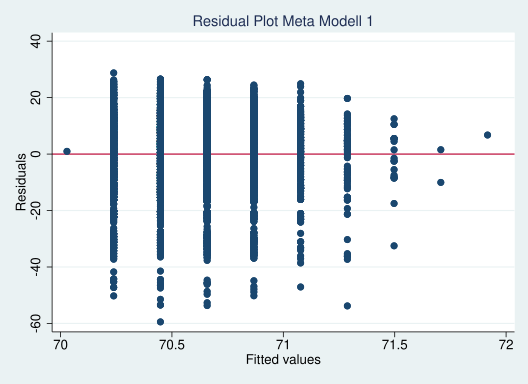

file Pictures/Stata/rvfplot_meta_uv.png written in PNG format
*******************************************************************************
> ***
************ Userscore nur UV *************************************************
> ***
*******************************************************************************
> ***

      Source |       SS           df       MS      Number of obs   =     7,500
-------------+----------------------------------   F(1, 7498)      =     32.27
       Model |  5345.83138         1  5345.83138   Prob > F        =    0.0000
    Residual |  1242193.08     7,498  165.669922   R-squared       =    0.0043
-------------+----------------------------------   Adj R-squared   =    0.0042
       Total |  1247538.91     7,499  166.360702   Root MSE        =    12.871

------------------------------------------------------------------------------
  user_score | Coefficient  Std. err.      t    P>|t|     [95% conf. interval]
-------------+--------------------------------

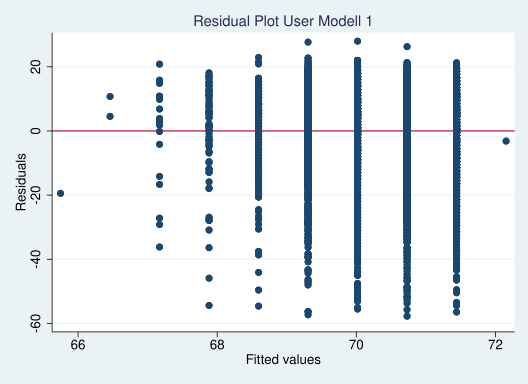

file Pictures/Stata/rvfplot_user_uv.png written in PNG format
*******************************************************************************
> ***
************ Metascore nur Dritt **********************************************
> ***
*******************************************************************************
> ***

      Source |       SS           df       MS      Number of obs   =     7,492
-------------+----------------------------------   F(10, 7481)     =     77.00
       Model |  109200.447        10  10920.0447   Prob > F        =    0.0000
    Residual |  1060889.23     7,481  141.811152   R-squared       =    0.0933
-------------+----------------------------------   Adj R-squared   =    0.0921
       Total |  1170089.68     7,491  156.199396   Root MSE        =    11.908

------------------------------------------------------------------------------
  meta_score | Coefficient  Std. err.      t    P>|t|     [95% conf. interval]
-------------+--------------------------------

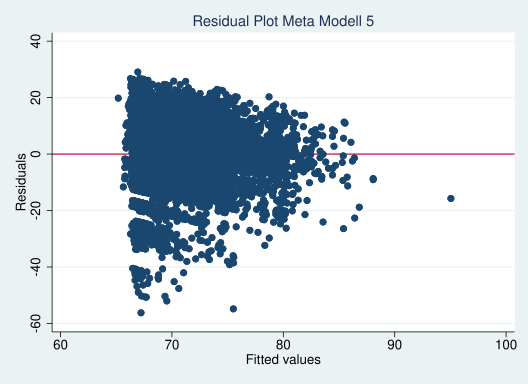

file Pictures/Stata/rvfplot_meta_dritt.png written in PNG format
*******************************************************************************
> ***
************ Userscore nur Dritt **********************************************
> ***
*******************************************************************************
> ***

      Source |       SS           df       MS      Number of obs   =     7,492
-------------+----------------------------------   F(10, 7481)     =     97.33
       Model |  143378.715        10  14337.8715   Prob > F        =    0.0000
    Residual |  1102056.25     7,481  147.314029   R-squared       =    0.1151
-------------+----------------------------------   Adj R-squared   =    0.1139
       Total |  1245434.97     7,491  166.257505   Root MSE        =    12.137

------------------------------------------------------------------------------
  user_score | Coefficient  Std. err.      t    P>|t|     [95% conf. interval]
-------------+-----------------------------

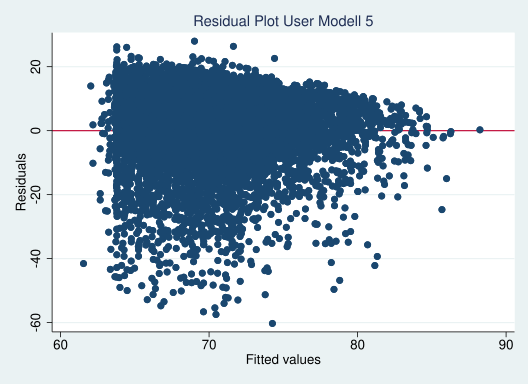

file Pictures/Stata/rvfplot_user_dritt.png written in PNG format
*******************************************************************************
> ***
************ Metascore ALL ****************************************************
> ***
*******************************************************************************
> ***

      Source |       SS           df       MS      Number of obs   =     7,492
-------------+----------------------------------   F(11, 7480)     =     70.24
       Model |   109544.92        11  9958.62908   Prob > F        =    0.0000
    Residual |  1060544.76     7,480  141.784059   R-squared       =    0.0936
-------------+----------------------------------   Adj R-squared   =    0.0923
       Total |  1170089.68     7,491  156.199396   Root MSE        =    11.907

------------------------------------------------------------------------------
  meta_score | Coefficient  Std. err.      t    P>|t|     [95% conf. interval]
-------------+-----------------------------

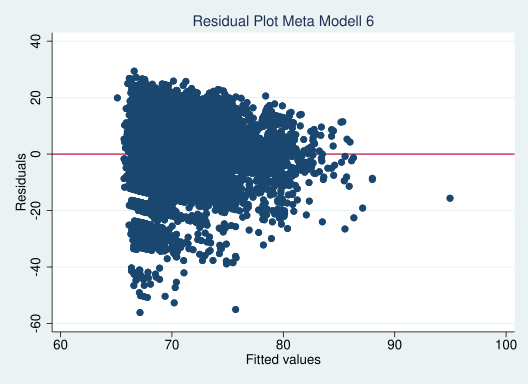

file Pictures/Stata/rvfplot_meta_all.png written in PNG format
*******************************************************************************
> ***
************ Userscore ALL ****************************************************
> ***
*******************************************************************************
> ***

      Source |       SS           df       MS      Number of obs   =     7,492
-------------+----------------------------------   F(11, 7480)     =     89.63
       Model |  145043.392        11  13185.7629   Prob > F        =    0.0000
    Residual |  1100391.57     7,480  147.111173   R-squared       =    0.1165
-------------+----------------------------------   Adj R-squared   =    0.1152
       Total |  1245434.97     7,491  166.257505   Root MSE        =    12.129

------------------------------------------------------------------------------
  user_score | Coefficient  Std. err.      t    P>|t|     [95% conf. interval]
-------------+-------------------------------

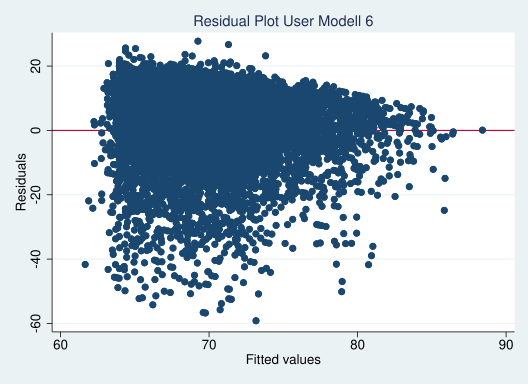

file Pictures/Stata/rvfplot_user_all.png written in PNG format
      name:  <unnamed>
       log:  c:\Users\Marek\Documents\GitHub\BachelorThesis\Stata/Stata_Output/
> Stata_Output_restest2.smcl
  log type:  smcl
 closed on:   8 Feb 2023, 20:44:28
-------------------------------------------------------------------------------
file Stata/Stata_Output/_restest2.pdf saved as PDF format


In [175]:
# METASCORE und USERSCORE:

# Erstellt eine Log-Datei, welche den Stata Output abspeichert
%stata log using Stata/Stata_Output/Stata_Output_restest2, replace

# Liest den erstellten Datensatz in Stata ein
%stata use Stata/Stata_Data/stata_data_more

# Führt verschiedene Regressionsanalysen durch
%stata di "**********************************************************************************"
%stata di "************ Metascore nur UV ****************************************************"
%stata di "**********************************************************************************"
%stata regress meta_score niche_width
%stata di "************ VIF Tabelle *******************************************************"
%stata vif
%stata rvfplot, yline(0) title(Residual Plot Meta Modell 1 , size(medium))
%stata graph export Pictures/Stata/rvfplot_meta_uv.png, width(3840) replace
%stata di "**********************************************************************************"
%stata di "************ Userscore nur UV ****************************************************"
%stata di "**********************************************************************************"
%stata regress user_score niche_width
%stata di "************ VIF Tabelle *******************************************************"
%stata vif
%stata rvfplot, yline(0) title(Residual Plot User Modell 1 , size(medium))
%stata graph export Pictures/Stata/rvfplot_user_uv.png, width(3840) replace

%stata di "**********************************************************************************"
%stata di "************ Metascore nur Dritt *************************************************"
%stata di "**********************************************************************************"
%stata regress meta_score platform_width year top10_genre_meta top10_genre_user top10_publisher_meta top10_publisher_user top10_developer_meta top10_developer_user publisher_activity developer_activity
%stata di "************ VIF Tabelle *******************************************************"
%stata vif
%stata rvfplot, yline(0) title(Residual Plot Meta Modell 5 , size(medium))
%stata graph export Pictures/Stata/rvfplot_meta_dritt.png, width(3840) replace
%stata di "**********************************************************************************"
%stata di "************ Userscore nur Dritt *************************************************"
%stata di "**********************************************************************************"
%stata regress user_score platform_width year top10_genre_meta top10_genre_user top10_publisher_meta top10_publisher_user top10_developer_meta top10_developer_user publisher_activity developer_activity
%stata di "************ VIF Tabelle *******************************************************"
%stata vif
%stata rvfplot, yline(0) title(Residual Plot User Modell 5 , size(medium))
%stata graph export Pictures/Stata/rvfplot_user_dritt.png, width(3840) replace

%stata di "**********************************************************************************"
%stata di "************ Metascore ALL *******************************************************"
%stata di "**********************************************************************************"
%stata regress meta_score niche_width platform_width year top10_genre_meta top10_genre_user top10_publisher_meta top10_publisher_user top10_developer_meta top10_developer_user publisher_activity developer_activity
%stata di "************ VIF Tabelle *******************************************************"
%stata vif
%stata rvfplot, yline(0) title(Residual Plot Meta Modell 6 , size(medium))
%stata graph export Pictures/Stata/rvfplot_meta_all.png, width(3840) replace
%stata di "**********************************************************************************"
%stata di "************ Userscore ALL *******************************************************"
%stata di "**********************************************************************************"
%stata regress user_score niche_width platform_width year top10_genre_meta top10_genre_user top10_publisher_meta top10_publisher_user top10_developer_meta top10_developer_user publisher_activity developer_activity
%stata di "************ VIF Tabelle *******************************************************"
%stata vif
%stata rvfplot, yline(0) title(Residual Plot User Modell 6 , size(medium))
%stata graph export Pictures/Stata/rvfplot_user_all.png, width(3840) replace


# Beendet das Log
%stata log close
# Schreibt den Stata Output in eine PDF-Datei um eine einfache Betrachtung zu ermöglichen
%stata translate Stata/Stata_Output/Stata_Output_restest2.smcl Stata/Stata_Output/_restest2.pdf
%stata clear


### 6.1. Regressionen mit Meta und User getrennt

-------------------------------------------------------------------------------
      name:  <unnamed>
       log:  c:\Users\Marek\Documents\GitHub\BachelorThesis\Stata/Stata_Output/
> Stata_Output_restest3.smcl
  log type:  smcl
 opened on:   8 Feb 2023, 20:44:29
*******************************************************************************
> ***
************ Metascore ohne Dummy *********************************************
> ***
*******************************************************************************
> ***

      Source |       SS           df       MS      Number of obs   =     7,492
-------------+----------------------------------   F(5, 7486)      =     71.22
       Model |  53130.1575         5  10626.0315   Prob > F        =    0.0000
    Residual |  1116959.52     7,486  149.206455   R-squared       =    0.0454
-------------+----------------------------------   Adj R-squared   =    0.0448
       Total |  1170089.68     7,491  156.199396   Root MSE        =    12.215

-

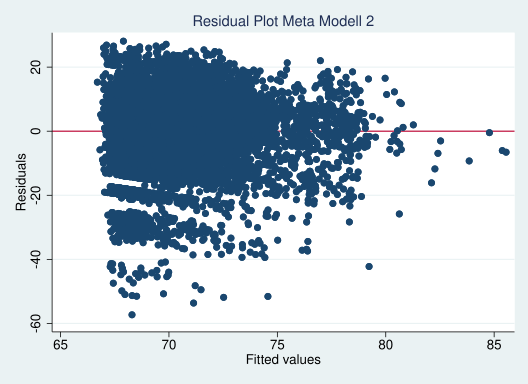

file Pictures/Stata/rvfplot_meta_ohneDummy.png written in PNG format
*******************************************************************************
> ***
************ Userscore ohne Dummy *********************************************
> ***
*******************************************************************************
> ***

      Source |       SS           df       MS      Number of obs   =     7,492
-------------+----------------------------------   F(5, 7486)      =    118.82
       Model |  91573.9949         5   18314.799   Prob > F        =    0.0000
    Residual |  1153860.97     7,486   154.13585   R-squared       =    0.0735
-------------+----------------------------------   Adj R-squared   =    0.0729
       Total |  1245434.97     7,491  166.257505   Root MSE        =    12.415

------------------------------------------------------------------------------
  user_score | Coefficient  Std. err.      t    P>|t|     [95% conf. interval]
-------------+-------------------------

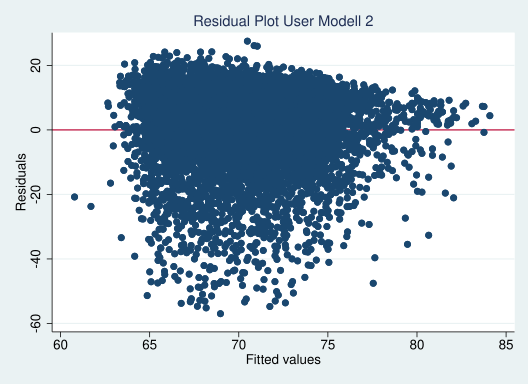

file Pictures/Stata/rvfplot_user_ohneDummy.png written in PNG format
*******************************************************************************
> ***
************ Metascore nur Dummy **********************************************
> ***
*******************************************************************************
> ***

      Source |       SS           df       MS      Number of obs   =     7,500
-------------+----------------------------------   F(4, 7495)      =     76.86
       Model |  46160.6271         4  11540.1568   Prob > F        =    0.0000
    Residual |   1125293.2     7,495  150.139186   R-squared       =    0.0394
-------------+----------------------------------   Adj R-squared   =    0.0389
       Total |  1171453.83     7,499  156.214672   Root MSE        =    12.253

------------------------------------------------------------------------------
  meta_score | Coefficient  Std. err.      t    P>|t|     [95% conf. interval]
-------------+-------------------------

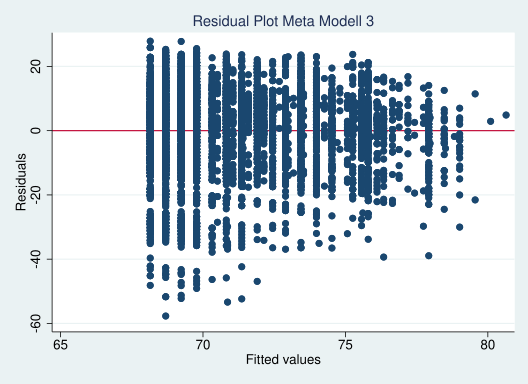

file Pictures/Stata/rvfplot_meta_Dummy.png written in PNG format
*******************************************************************************
> ***
************ Userscore nur Dummy **********************************************
> ***
*******************************************************************************
> ***

      Source |       SS           df       MS      Number of obs   =     7,500
-------------+----------------------------------   F(4, 7495)      =     68.77
       Model |     44163.1         4   11040.775   Prob > F        =    0.0000
    Residual |  1203375.81     7,495  160.557146   R-squared       =    0.0354
-------------+----------------------------------   Adj R-squared   =    0.0349
       Total |  1247538.91     7,499  166.360702   Root MSE        =    12.671

------------------------------------------------------------------------------
  user_score | Coefficient  Std. err.      t    P>|t|     [95% conf. interval]
-------------+-----------------------------

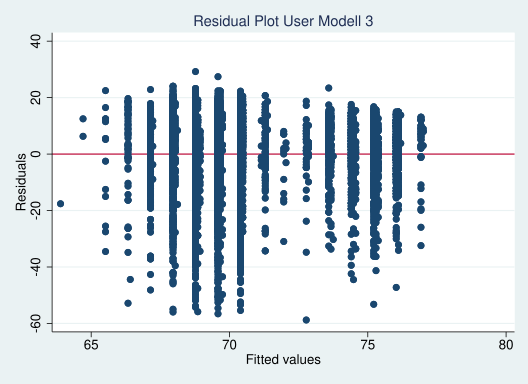

file Pictures/Stata/rvfplot_user_Dummy.png written in PNG format
*******************************************************************************
> ***
************ Metascore ALL Getrennt *******************************************
> ***
*******************************************************************************
> ***

      Source |       SS           df       MS      Number of obs   =     7,492
-------------+----------------------------------   F(8, 7483)      =     64.35
       Model |   75319.073         8  9414.88412   Prob > F        =    0.0000
    Residual |   1094770.6     7,483   146.30103   R-squared       =    0.0644
-------------+----------------------------------   Adj R-squared   =    0.0634
       Total |  1170089.68     7,491  156.199396   Root MSE        =    12.095

------------------------------------------------------------------------------
  meta_score | Coefficient  Std. err.      t    P>|t|     [95% conf. interval]
-------------+-----------------------------

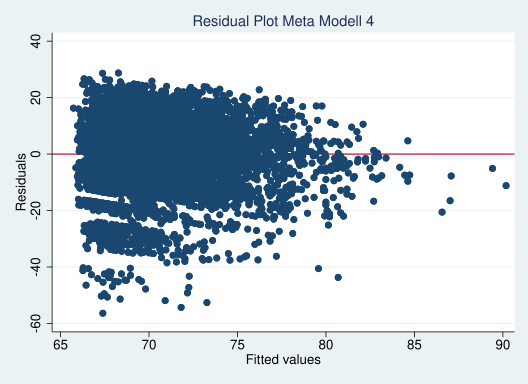

file Pictures/Stata/rvfplot_meta_all_getrennt.png written in PNG format
*******************************************************************************
> ***
************ Userscore ALL ****************************************************
> ***
*******************************************************************************
> ***

      Source |       SS           df       MS      Number of obs   =     7,492
-------------+----------------------------------   F(8, 7483)      =     93.04
       Model |  112672.485         8  14084.0606   Prob > F        =    0.0000
    Residual |  1132762.48     7,483  151.378121   R-squared       =    0.0905
-------------+----------------------------------   Adj R-squared   =    0.0895
       Total |  1245434.97     7,491  166.257505   Root MSE        =    12.304

------------------------------------------------------------------------------
  user_score | Coefficient  Std. err.      t    P>|t|     [95% conf. interval]
-------------+----------------------

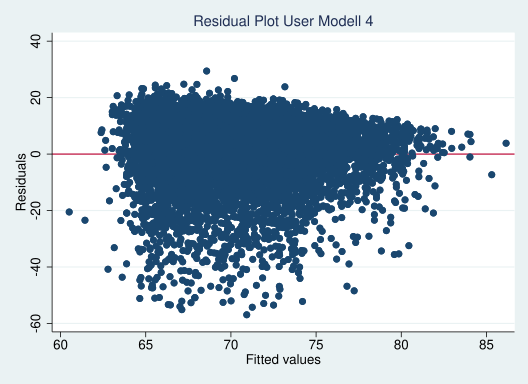

file Pictures/Stata/rvfplot_user_all_getrennt.png written in PNG format
      name:  <unnamed>
       log:  c:\Users\Marek\Documents\GitHub\BachelorThesis\Stata/Stata_Output/
> Stata_Output_restest3.smcl
  log type:  smcl
 closed on:   8 Feb 2023, 20:44:49
-------------------------------------------------------------------------------
file Stata/Stata_Output/_restest3.pdf saved as PDF format


In [176]:
# METASCORE und USERSCORE:

# Erstellt eine Log-Datei, welche den Stata Output abspeichert
%stata log using Stata/Stata_Output/Stata_Output_restest3, replace

# Liest den erstellten Datensatz in Stata ein
%stata use Stata/Stata_Data/stata_data_more

# Führt verschiedene Regressionsanalysen durch
%stata di "**********************************************************************************"
%stata di "************ Metascore ohne Dummy ************************************************"
%stata di "**********************************************************************************"
%stata regress meta_score niche_width platform_width year publisher_activity developer_activity
%stata di "************ VIF Tabelle *******************************************************"
%stata vif
%stata rvfplot, yline(0) title(Residual Plot Meta Modell 2 , size(medium))
%stata graph export Pictures/Stata/rvfplot_meta_ohneDummy.png, width(3840) replace
%stata di "**********************************************************************************"
%stata di "************ Userscore ohne Dummy ************************************************"
%stata di "**********************************************************************************"
%stata regress user_score niche_width platform_width year publisher_activity developer_activity
%stata di "************ VIF Tabelle *******************************************************"
%stata vif
%stata rvfplot, yline(0) title(Residual Plot User Modell 2 , size(medium))
%stata graph export Pictures/Stata/rvfplot_user_ohneDummy.png, width(3840) replace

%stata di "**********************************************************************************"
%stata di "************ Metascore nur Dummy *************************************************"
%stata di "**********************************************************************************"
%stata regress meta_score niche_width top10_genre_user top10_publisher_user top10_developer_user
%stata di "************ VIF Tabelle *******************************************************"
%stata vif
%stata rvfplot, yline(0) title(Residual Plot Meta Modell 3 , size(medium))
%stata graph export Pictures/Stata/rvfplot_meta_Dummy.png, width(3840) replace
%stata di "**********************************************************************************"
%stata di "************ Userscore nur Dummy *************************************************"
%stata di "**********************************************************************************"
%stata regress user_score niche_width top10_genre_meta top10_publisher_meta top10_developer_meta
%stata di "************ VIF Tabelle *******************************************************"
%stata vif
%stata rvfplot, yline(0) title(Residual Plot User Modell 3 , size(medium))
%stata graph export Pictures/Stata/rvfplot_user_Dummy.png, width(3840) replace

%stata di "**********************************************************************************"
%stata di "************ Metascore ALL Getrennt **********************************************"
%stata di "**********************************************************************************"
%stata regress meta_score niche_width platform_width year top10_genre_user top10_publisher_user top10_developer_user publisher_activity developer_activity
%stata di "************ VIF Tabelle *******************************************************"
%stata vif
%stata rvfplot, yline(0) title(Residual Plot Meta Modell 4 , size(medium))
%stata graph export Pictures/Stata/rvfplot_meta_all_getrennt.png, width(3840) replace
%stata di "**********************************************************************************"
%stata di "************ Userscore ALL *******************************************************"
%stata di "**********************************************************************************"
%stata regress user_score niche_width platform_width year top10_genre_meta top10_publisher_meta top10_developer_meta publisher_activity developer_activity
%stata di "************ VIF Tabelle *******************************************************"
%stata vif
%stata rvfplot, yline(0) title(Residual Plot User Modell 4 , size(medium))
%stata graph export Pictures/Stata/rvfplot_user_all_getrennt.png, width(3840) replace


# Beendet das Log
%stata log close
# Schreibt den Stata Output in eine PDF-Datei um eine einfache Betrachtung zu ermöglichen
%stata translate Stata/Stata_Output/Stata_Output_restest3.smcl Stata/Stata_Output/_restest3.pdf
%stata clear


### 6.2. Code für Beispiel Rechnungen


In [177]:
#Metascore Formel:
Y = 0.46*a + 1.9*b + 0.07*c + 0.01*d + 0.06*e + 2.81*f + 4.14*g - 2.87*h + 62,71

TypeError: can't multiply sequence by non-int of type 'float'

In [ ]:
#Metascore Rechner:
a=3
b=1
c=25
d=305
e=13
f=0
g=1
h=0
Y = 0.46*a + 1.9*b + 0.07*c + 0.01*d + 0.06*e + 2.81*f + 4.14*g - 2.87*h + 62,71
print(Y)

(75.0, 71)


In [ ]:
#Userscore Formel:
Y = - 0.84*a + 0.29*b  -0.48*c + 0.00*d + 0.05*e + 0.05*f + 4.89*g - 3.18*h + 62.71

In [181]:
#Userscore Rechner:
a=3
b=1
c=25
d=305
e=13
f=0
g=1
h=0

Y = - 0.84*a + 0.29*b  -0.48*c + 0.00*d + 0.05*e + 0.05*f + 4.89*g - 3.18*h + 62.71
print(Y)

54.019999999999996


In [180]:
top10_meta_genres

['4X',
 'IceHockey',
 'Sim',
 'Football',
 'Soccer',
 'Western-Style',
 'MassivelyMultiplayer',
 'Open-World',
 'Baseball',
 'Console-styleRPG']

In [ ]:
#Code für Latex Tabellen:

#%stata clear
# Liest den erstellten Datensatz in Stata ein
#%stata use Stata/Stata_Data/stata_data_more

#Code für Metascore Regressionen:
#%stata ssc install estout, replace
#%stata eststo: regress meta_score niche_width 
#%stata eststo: regress meta_score niche_width platform_width year publisher_activity developer_activity
#%stata eststo: regress meta_score niche_width top10_genre_user top10_publisher_user top10_developer_user
#%stata eststo: regress meta_score niche_width platform_width year top10_genre_user top10_publisher_user top10_developer_user publisher_activity developer_activity
#%stata eststo: regress meta_score platform_width year top10_genre_meta top10_genre_user top10_publisher_meta top10_publisher_user top10_developer_meta top10_developer_user publisher_activity developer_activity
#%stata eststo: regress meta_score niche_width platform_width year top10_genre_meta top10_genre_user top10_publisher_meta top10_publisher_user top10_developer_meta top10_developer_user publisher_activity developer_activity
#%stata esttab using meta_reg.tex, label title(Regression table\label{tab1})
#%stata clear

#Code für Latex Tabellen
# Liest den erstellten Datensatz in Stata ein
#%stata use Stata/Stata_Data/stata_data_more
#Code für Userscore Regressionen:
#%stata eststo: regress user_score niche_width 
#%stata eststo: regress user_score niche_width platform_width year publisher_activity developer_activity
#%stata eststo: regress user_score niche_width top10_genre_meta top10_publisher_meta top10_developer_meta
#%stata eststo: regress user_score niche_width platform_width year top10_genre_meta top10_publisher_meta top10_developer_meta publisher_activity developer_activity
#%stata eststo: regress user_score platform_width year top10_genre_meta top10_genre_user top10_publisher_meta top10_publisher_user top10_developer_meta top10_developer_user publisher_activity developer_activity
#%stata eststo: regress user_score niche_width platform_width year top10_genre_meta top10_genre_user top10_publisher_meta top10_publisher_user top10_developer_meta top10_developer_user publisher_activity developer_activity
#%stata esttab using user_reg.tex, label title(Regression table\label{tab1})
#%stata clear


      Source |       SS           df       MS      Number of obs   =     7,500
-------------+----------------------------------   F(1, 7498)      =      2.97
       Model |  464.550229         1  464.550229   Prob > F        =    0.0846
    Residual |  1170989.28     7,498   156.17355   R-squared       =    0.0004
-------------+----------------------------------   Adj R-squared   =    0.0003
       Total |  1171453.83     7,499  156.214672   Root MSE        =    12.497

------------------------------------------------------------------------------
  meta_score | Coefficient  Std. err.      t    P>|t|     [95% conf. interval]
-------------+----------------------------------------------------------------
 niche_width |   .2097737   .1216294     1.72   0.085     -.028654    .4482014
       _cons |   69.81905   .4448443   156.95   0.000     68.94703    70.69107
------------------------------------------------------------------------------
(est1 stored)

      Source |       SS           d